# Load

In [1]:
%load_ext autoreload
%autoreload 2
%pylab inline
%matplotlib inline

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
from anndata import AnnData
from scipy.sparse import diags
from scipy.io import mmwrite
from scipy import sparse
from scipy.optimize import fsolve,minimize
from tqdm import tqdm
from pathlib import Path
from typing import Union, Optional
import pickle
import seaborn as sns

In [3]:
matplotlib.__version__

'3.8.1'

In [4]:
from scipy.sparse import csr_matrix

In [5]:
from scDenorm.denorm import *

In [6]:
from scAnnot.tools import *

In [7]:
import matplotlib as mpl
sc.set_figure_params(scanpy=True, fontsize=14,facecolor=None,frameon=False,transparent=True)
mpl.rcParams['axes.spines.top'] = False
mpl.rcParams['axes.spines.right'] = False
mpl.rcParams['axes.grid'] = False

In [8]:
def solve_bc(p,y1,y2):
    return sum((np.exp(y2*np.log(p[0]))-2*np.exp(y1*np.log(p[0]))+p[1])**2)

In [9]:
from scipy.optimize import curve_fit

def fit_nb(ms):
    
    def nb_func(x, phi):
        return x[0] + (phi * x[0] ** 2)
    
    popt, _ = curve_fit(nb_func, ms['mean'], ms['var'], p0=[1])
    phi = popt[0]
    
    ms['zeros_p'] = np.exp(-ms['mean'])
    ms['zeros_nb'] = (1 + phi * ms['mean']) ** (-1 / phi)
    ms['newVar'] = ms['mean'] + phi * ms['mean'] ** 2
    return ms

In [10]:
def plot_mv(cmean,cvar,ax,title,c='blue',fit=False,save=None):
    ax.loglog()
    ax.scatter(cmean, cvar,s=20,c=c)
    lims = [
        np.min([ax.get_xlim(), ax.get_ylim()]),  # min of both axes
        np.max([ax.get_xlim(), ax.get_ylim()]),  # max of both axes
    ]

    ax.plot(lims, lims, linestyle='--', linewidth=2, alpha=0.75, zorder=0,color='black', label='line')
    ax.set_aspect('equal')
    ax.set_xlim(lims)
    ax.set_ylim(lims)
    ax.spines[['right', 'top']].set_visible(False)
    ax.set_xlabel('Mean')
    ax.set_ylabel('Variance')
    ax.set_title(title)
    
    if fit:
        ms=pd.DataFrame({'mean':cmean[0],'var':cvar[0]})
        ms=fit_nb(ms)
        ms=ms.sort_values('mean')
        ax.plot(ms['mean'],ms['newVar'],'k-', alpha=1, zorder=ms.shape[0],color='red', label='line')
    if save:
        plt.savefig(save,dpi=300, bbox_inches='tight',transparent=True)

In [11]:
def read_cellbrowser(folder):
    ad = sc.read_text(f'{folder}/exprMatrix.tsv.gz').T
    meta = pd.read_csv(f'{folder}/meta.tsv', sep="\t",index_col=0)
    ad.obs = meta
    ad.X=csr_matrix(ad.X)
    print(folder,ad.X.data)
    return ad

In [12]:
sc.__version__

'1.9.6'

# Read UCB datasets

In [13]:
autism=read_cellbrowser('data/cellbrowserdatasets/autism/')

data/cellbrowserdatasets/autism/ [3.7990766 3.7990766 3.7990766 ... 2.7960377 2.7960377 2.7960377]


In [14]:
autism

AnnData object with n_obs × n_vars = 104559 × 36501
    obs: 'cluster', 'sample', 'individual', 'region', 'age', 'sex', 'diagnosis', 'Capbatch', 'Seqbatch', 'post-mortem interval (hours)', 'RNA Integrity Number', 'genes', 'UMIs', 'RNA mitochondr. percent', 'RNA ribosomal percent'

In [15]:
autism.obs

,cluster,sample,individual,region,age,sex,diagnosis,Capbatch,Seqbatch,post-mortem interval (hours),RNA Integrity Number,genes,UMIs,RNA mitochondr. percent,RNA ribosomal percent
cell,,,,,,,,,,,,,,,
AAACCTGGTACGCACC-1_1823_BA24,Neu-NRGN-II,1823_BA24,1823,ACC,15,M,Control,CB8,SB3,18,7.0,622,774,2.454780,1.421189
AAACGGGCACCAGATT-1_1823_BA24,L5/6,1823_BA24,1823,ACC,15,M,Control,CB8,SB3,18,7.0,6926,24042,0.445055,0.428417
AAAGATGAGTCCAGGA-1_1823_BA24,Oligodendrocytes,1823_BA24,1823,ACC,15,M,Control,CB8,SB3,18,7.0,624,830,0.240964,0.722892
AAAGATGTCTTGAGGT-1_1823_BA24,OPC,1823_BA24,1823,ACC,15,M,Control,CB8,SB3,18,7.0,1192,1771,0.225861,1.806889
AAAGCAAGTAATCACC-1_1823_BA24,Oligodendrocytes,1823_BA24,1823,ACC,15,M,Control,CB8,SB3,18,7.0,691,895,0.558659,0.670391
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCACAAAGTCAA-1_6033_BA9,L5/6,6033_BA9,6033,PFC,14,F,ASD,CB7,SB2,25,8.0,4555,10514,2.805783,1.245958
TTTGTCACAAGGCTCC-1_6033_BA9,OPC,6033_BA9,6033,PFC,14,F,ASD,CB7,SB2,25,8.0,913,1276,0.156740,0.548589
TTTGTCAGTCGATTGT-1_6033_BA9,Neu-mat,6033_BA9,6033,PFC,14,F,ASD,CB7,SB2,25,8.0,1807,2874,0.591510,0.765484


In [ ]:
df=pd.Series(autism.var_names).str.split('|', expand=True)

In [ ]:
df.columns=['gene_ids','gene_names']
df.index=list(df.gene_names)

In [ ]:
autism.var=df

In [ ]:
autism.write_h5ad('data/integration/autism.h5ad')

... storing 'cluster' as categorical
... storing 'sample' as categorical
... storing 'region' as categorical
... storing 'sex' as categorical
... storing 'diagnosis' as categorical
... storing 'Capbatch' as categorical
... storing 'Seqbatch' as categorical
... storing 'gene_names' as categorical


In [56]:
autism=autism[:,~autism.var_names.duplicated()]

In [57]:
autism

View of AnnData object with n_obs × n_vars = 104559 × 36254
    obs: 'cluster', 'sample', 'individual', 'region', 'age', 'sex', 'diagnosis', 'Capbatch', 'Seqbatch', 'post-mortem interval (hours)', 'RNA Integrity Number', 'genes', 'UMIs', 'RNA mitochondr. percent', 'RNA ribosomal percent'
    var: 'gene_ids', 'gene_names'

In [16]:
autism.obs.diagnosis.value_counts()

Control    52556
ASD        52003
Name: diagnosis, dtype: int64

In [17]:
autism.obs.region.value_counts()

PFC    62166
ACC    42393
Name: region, dtype: int64

In [18]:
autism.obs.cluster.value_counts()

Oligodendrocytes    15371
L2/3                13324
OPC                 10123
Neu-NRGN-II          8317
AST-PP               7655
L4                   6858
IN-VIP               5974
L5/6-CC              4617
IN-SST               4569
AST-FB               4562
Neu-mat              4135
IN-PV                4037
L5/6                 3561
Neu-NRGN-I           3543
Microglia            3331
Endothelial          2668
IN-SV2C              1914
Name: cluster, dtype: int64

# Raw count 1

In [106]:
ad_Vel=sc.read('/home/huang_ziliang/project/brain/data/public/human_brain_source_Velmeshev_2019/h5/annot.h5ad')

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [107]:
ad_Vel

AnnData object with n_obs × n_vars = 104559 × 65217
    obs: 'cluster', 'sample', 'individual', 'region', 'age', 'sex', 'diagnosis', 'Capbatch', 'Seqbatch', 'post-mortem interval (hours)', 'RNA Integrity Number', 'genes', 'UMIs', 'RNA mitochondr. percent', 'RNA ribosomal percent', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'cell_ID', 'seq_tech', 'donor_ID', 'donor_gender', 'organ', 'reference', 'original_name2', 'sample_type', 'species', 'ethnicity', 'treatment', 'project_code', 'seq_method', 'subregion', 'donor_status', 'sample_status', 'original_name', 'if_patient', 'sample_ID', 'donor_age', 'Siletti_singleCellNet', 'Siletti_SingleR', 'Siletti_scPred', 'Siletti_scMap', 'Siletti_CHETAH', 'Siletti_scArches', 'Siletti_ACTINN', 'Siletti_modf_SCANVI_L1', 'Siletti_modf_SCANVI_L2', 'cell_type'
    var: 'gene_ids', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable',

In [108]:
ad=sc.read('/home/huang_ziliang/project/brain/data/public/human_chimp_macaque_PFC_Ma_2022_ATAC-seq_10x/h5/snRNA-seq_Human_annot.h5ad')

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [109]:
ad.layers['counts']=ad.X.copy()

In [110]:
ad1=ad.concatenate(ad_Vel)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/anndata/_core/anndata.py:1823: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/anndata/_core/merge.py:1348: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(


In [111]:
ad1

AnnData object with n_obs × n_vars = 276679 × 25943
    obs: 'subtype', 'subclass', 'class', 'samplename', 'tech_rep', 'species', 'sample', 'donor_gender', 'donor_age', 'cell_ID', 'organ', 'project_code', 'reference', 'seq_tech', 'sample_type', 'seq_method', 'treatment', 'region', 'subregion', 'donor_ID', 'original_name', 'original_name2', 'donor_status', 'sample_status', 'if_patient', 'ethnicity', 'sample_ID', 'Siletti_singleCellNet', 'Siletti_SingleR', 'Siletti_scPred', 'Siletti_scMap', 'Siletti_CHETAH', 'Siletti_scArches', 'Siletti_ACTINN', 'Siletti_modf_SCANVI_L1', 'Siletti_modf_SCANVI_L2', 'cell_type', 'cluster', 'individual', 'age', 'sex', 'diagnosis', 'Capbatch', 'Seqbatch', 'post-mortem interval (hours)', 'RNA Integrity Number', 'genes', 'UMIs', 'RNA mitochondr. percent', 'RNA ribosomal percent', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'batch'
    var: 'gene_ids-1', 'mt-1', 'n_cells_by_counts-1', '

In [112]:
sc.pp.highly_variable_genes(
    ad1,
    flavor="seurat_v3",
    n_top_genes=2000,
    layer="counts",
    batch_key="sample",
    subset=False
)

In [113]:
sc.pp.normalize_total(ad1, target_sum=1e4)
sc.pp.log1p(ad1)

In [114]:
sc.tl.pca(ad1, svd_solver='arpack', use_highly_variable=True)
sc.pp.neighbors(ad1)
sc.tl.umap(ad1)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


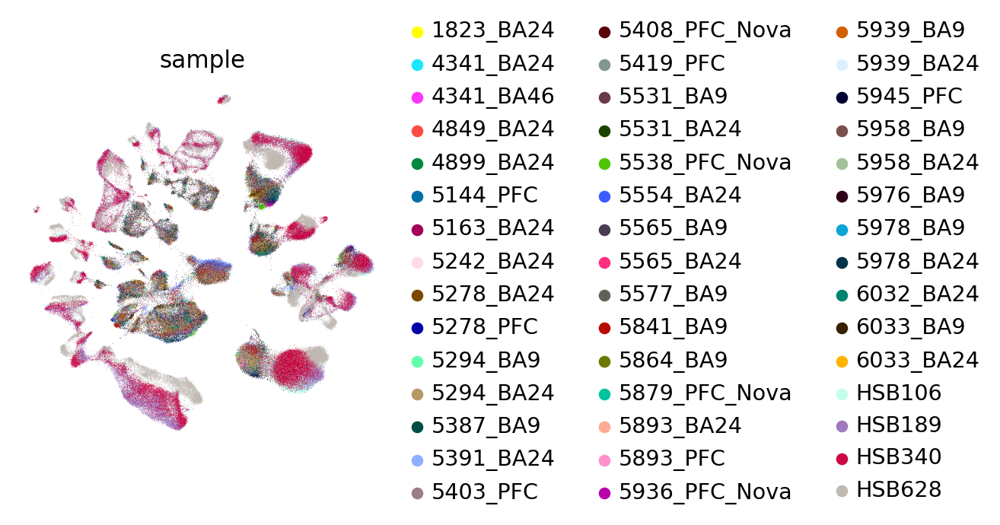

In [115]:
sc.pl.umap(ad1, color=['sample'])

In [116]:
ad1.obs['batch']=ad1.obs['batch'].replace({'0':'Ma et al. Science. 2022.',
                                          '1':'Velmeshev et al. Science. 2019.'})

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


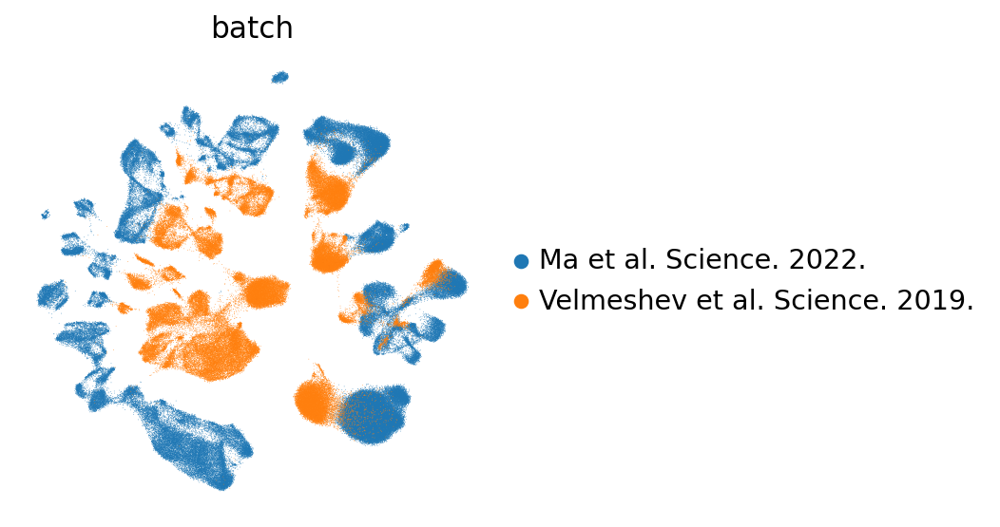

In [117]:
sc.pl.umap(ad1, color=['batch'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


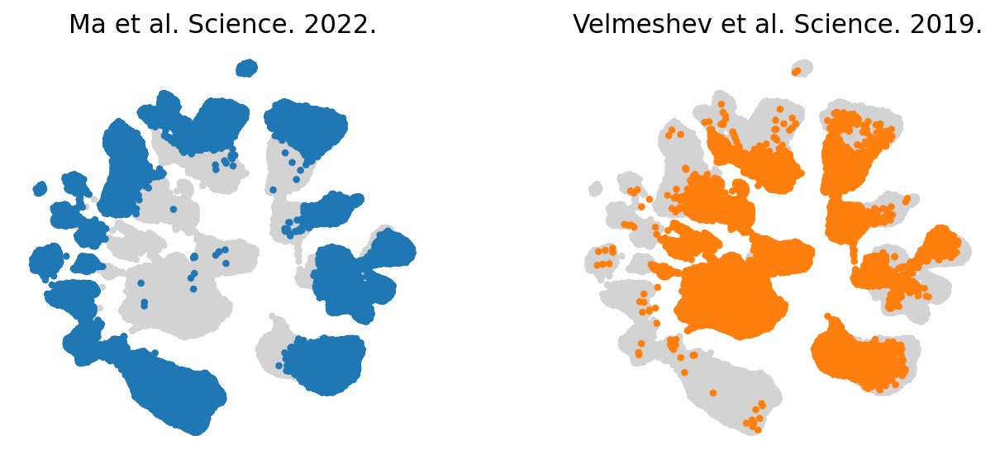

In [118]:
cluster_small_multiples(ad1,'batch')

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


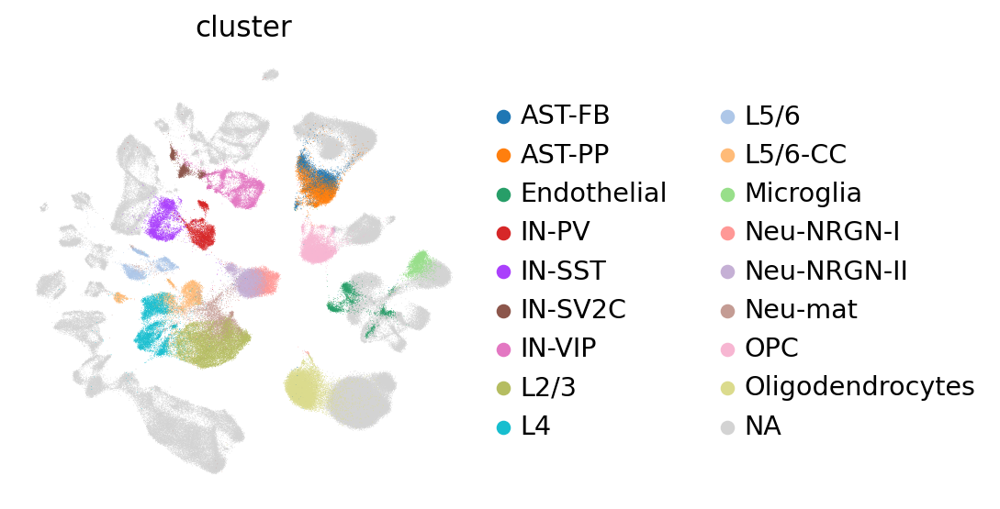

In [119]:
sc.pl.umap(ad1, color=['cluster'])

In [120]:
ad1.obsm['X_umap_raw']=ad1.obsm['X_umap']

In [121]:
sc.external.pp.harmony_integrate(ad1, key = ['batch'])

2023-11-17 17:27:26,960 - harmonypy - INFO - Iteration 1 of 10
INFO:harmonypy:Iteration 1 of 10
2023-11-17 17:29:48,756 - harmonypy - INFO - Iteration 2 of 10
INFO:harmonypy:Iteration 2 of 10
2023-11-17 17:32:27,330 - harmonypy - INFO - Iteration 3 of 10
INFO:harmonypy:Iteration 3 of 10
2023-11-17 17:35:08,772 - harmonypy - INFO - Converged after 3 iterations
INFO:harmonypy:Converged after 3 iterations


In [122]:
sc.pp.neighbors(ad1, use_rep='X_pca_harmony')
sc.tl.umap(ad1)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


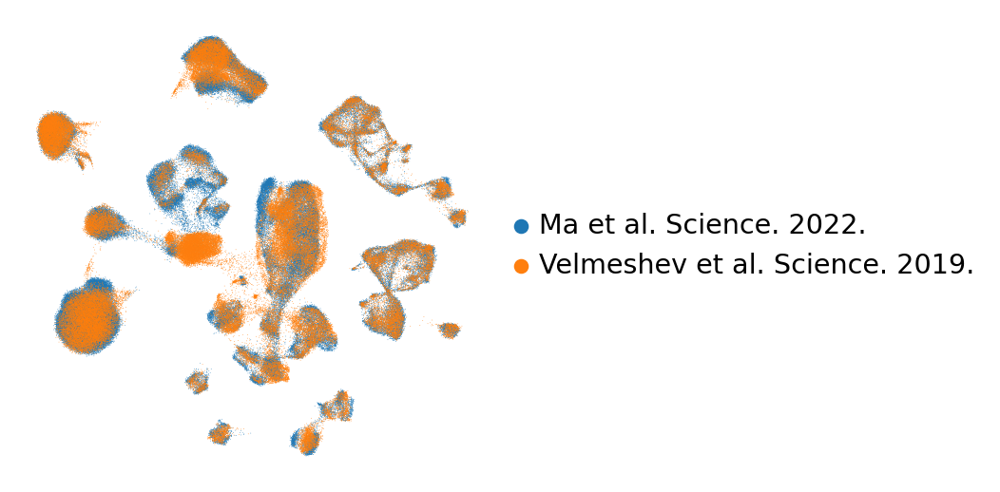

In [123]:
sc.pl.umap(ad1, color=['batch'],title='')

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


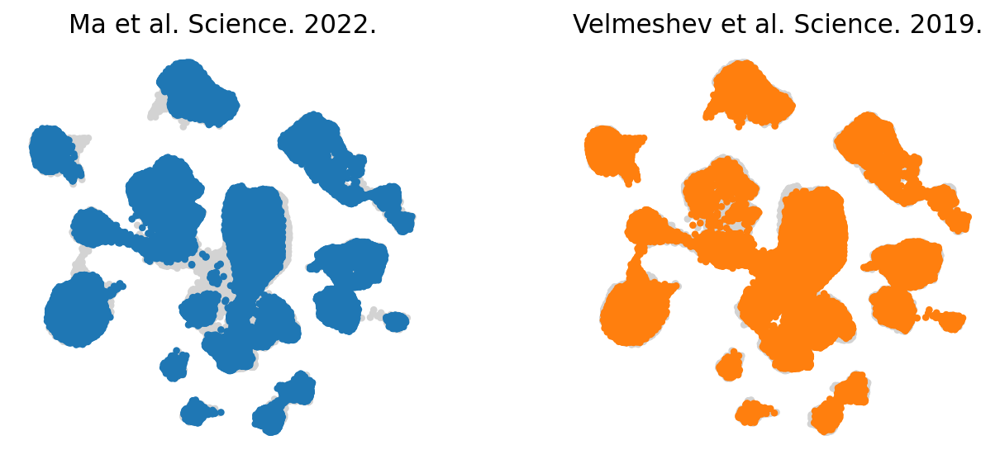

In [124]:
cluster_small_multiples(ad1,'batch')

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


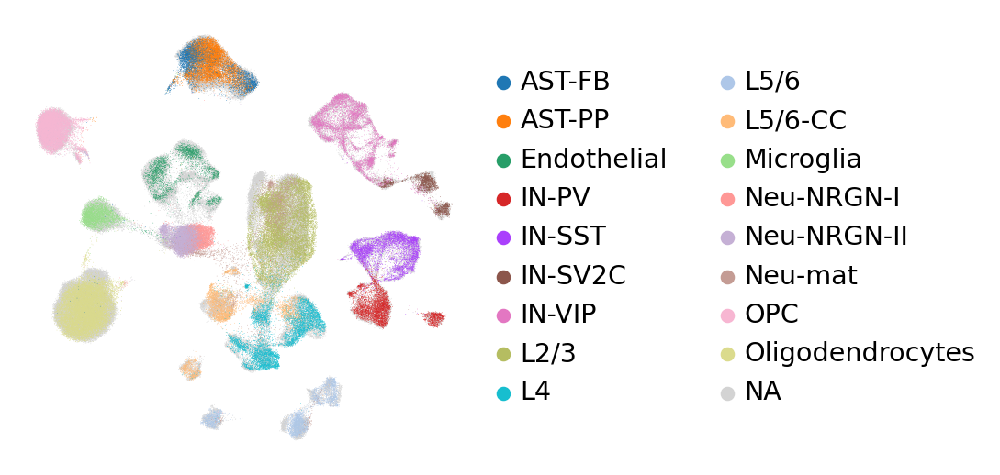

In [125]:
sc.pl.umap(ad1, color=['cluster'],title='')

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


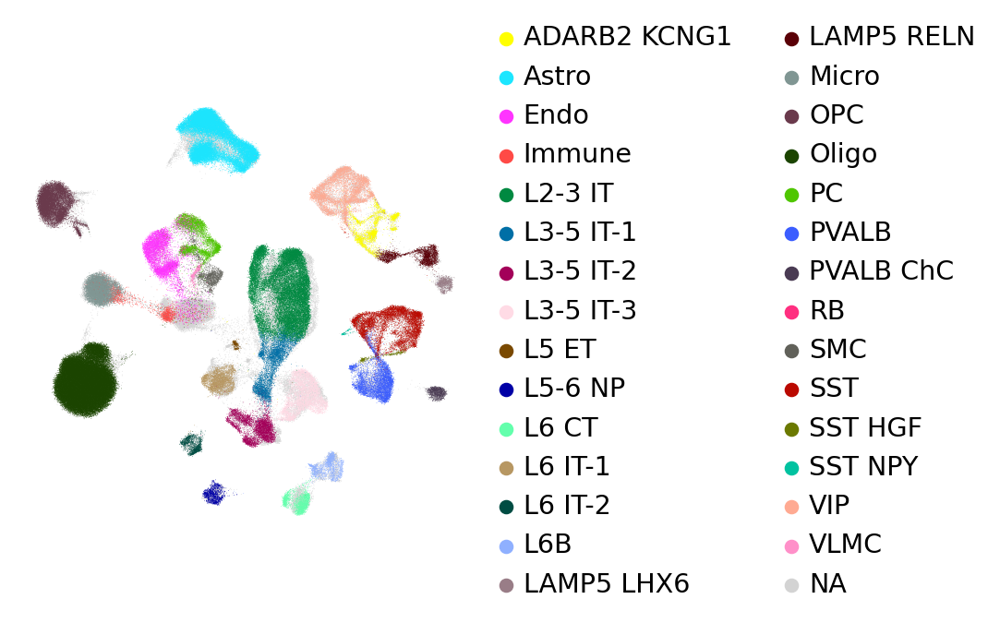

In [126]:
sc.pl.umap(ad1, color=['subclass'],title='')

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


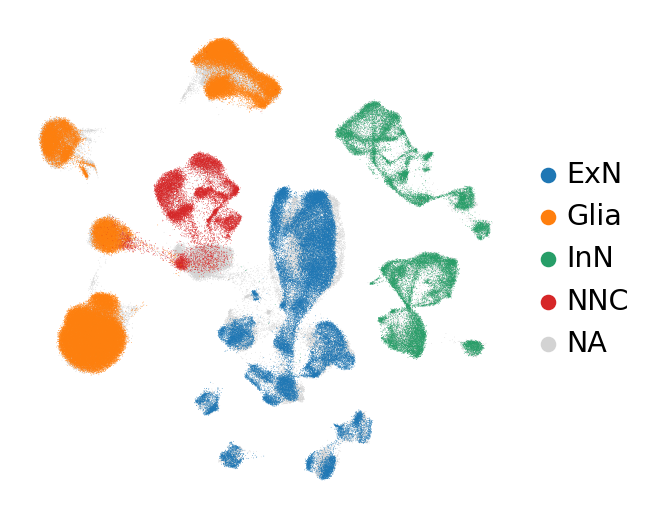

In [127]:
sc.pl.umap(ad1, color=['class'],title='')

In [100]:
sc.tl.louvain(ad1,resolution=0.3)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


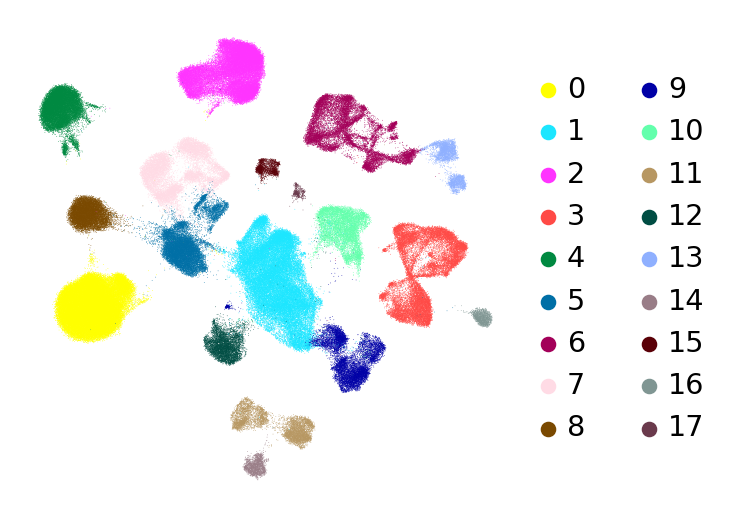

In [101]:
sc.pl.umap(ad1, color=['louvain'],title='')

In [102]:
ad1.write_h5ad('data/integration/raw_count1.h5ad')

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping prov

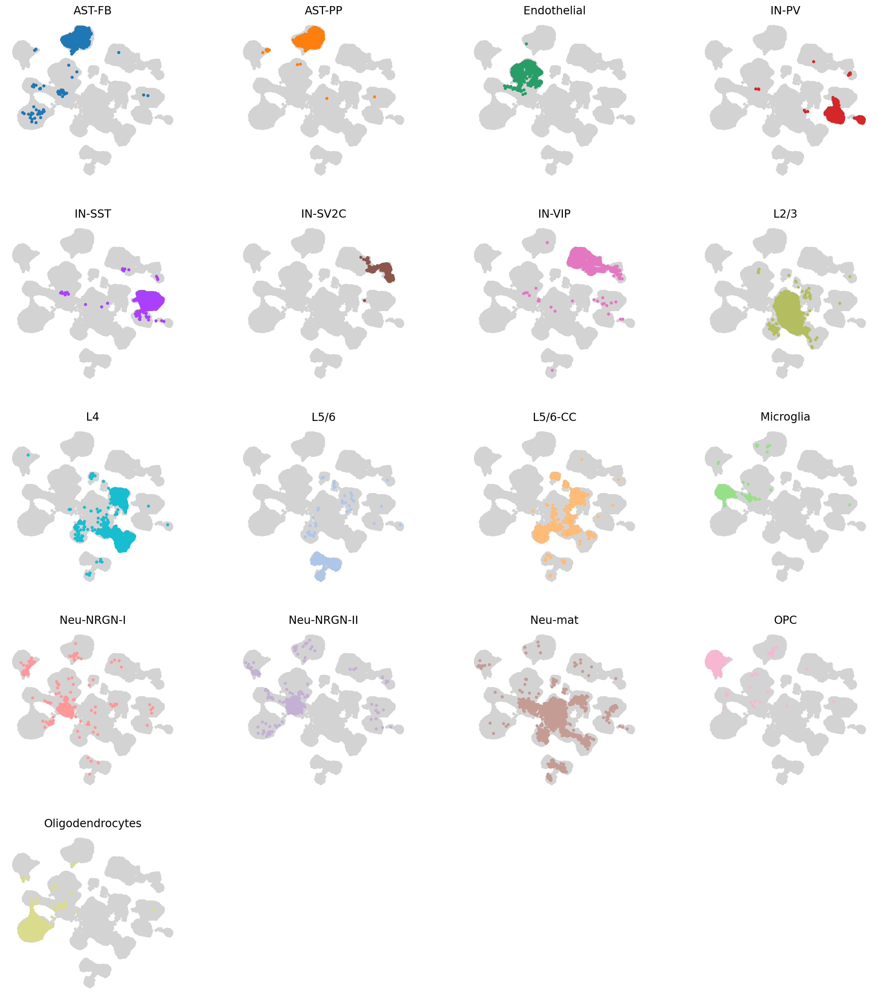

In [103]:
cluster_small_multiples(ad1,'cluster')

In [104]:
ad1=ad1[:,~ad1.var_names.isin(['PC','PVALB','SST','VIP'])]

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping prov

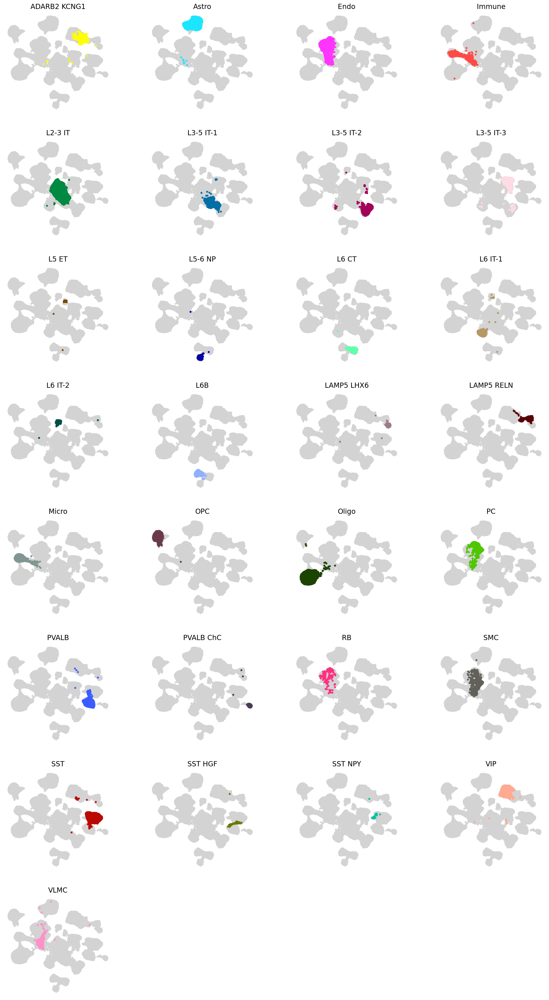

In [105]:
cluster_small_multiples(ad1,'subclass')

# Raw count 2

In [46]:
autism=sc.read('data/integration/autism.h5ad')

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/anndata/_core/anndata.py:1900: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [64]:
autism_dn=scdenorm(autism)

ERROR:root:The base 2.718281828459045 is not match with the data.
ERROR:root:The base 1 is not match with the data.
100%|██████████| 104559/104559 [00:34<00:00, 3037.84it/s]


In [67]:
autism_dn.layers['counts']=autism_dn.X.copy()

In [41]:
ad=sc.read('/home/huang_ziliang/project/brain/data/public/human_chimp_macaque_PFC_Ma_2022_ATAC-seq_10x/h5/snRNA-seq_Human_annot.h5ad')

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [68]:
ad.layers['counts']=ad.X.copy()

In [69]:
ad1=ad.concatenate(autism_dn)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/anndata/_core/anndata.py:1823: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


In [70]:
ad1

AnnData object with n_obs × n_vars = 276679 × 23063
    obs: 'subtype', 'subclass', 'class', 'samplename', 'tech_rep', 'species', 'sample', 'donor_gender', 'donor_age', 'cell_ID', 'organ', 'project_code', 'reference', 'seq_tech', 'sample_type', 'seq_method', 'treatment', 'region', 'subregion', 'donor_ID', 'original_name', 'original_name2', 'donor_status', 'sample_status', 'if_patient', 'ethnicity', 'sample_ID', 'Siletti_singleCellNet', 'Siletti_SingleR', 'Siletti_scPred', 'Siletti_scMap', 'Siletti_CHETAH', 'Siletti_scArches', 'Siletti_ACTINN', 'Siletti_modf_SCANVI_L1', 'Siletti_modf_SCANVI_L2', 'cell_type', 'cluster', 'individual', 'age', 'sex', 'diagnosis', 'Capbatch', 'Seqbatch', 'post-mortem interval (hours)', 'RNA Integrity Number', 'genes', 'UMIs', 'RNA mitochondr. percent', 'RNA ribosomal percent', 'batch'
    var: 'gene_ids-1', 'gene_names-1'
    layers: 'counts'

In [71]:
sc.pp.highly_variable_genes(
    ad1,
    flavor="seurat_v3",
    n_top_genes=2000,
    layer="counts",
    batch_key="sample",
    subset=False
)

In [72]:
sc.pp.normalize_total(ad1, target_sum=1e4)
sc.pp.log1p(ad1)

In [73]:
sc.tl.pca(ad1, svd_solver='arpack', use_highly_variable=True)
sc.pp.neighbors(ad1)
sc.tl.umap(ad1)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


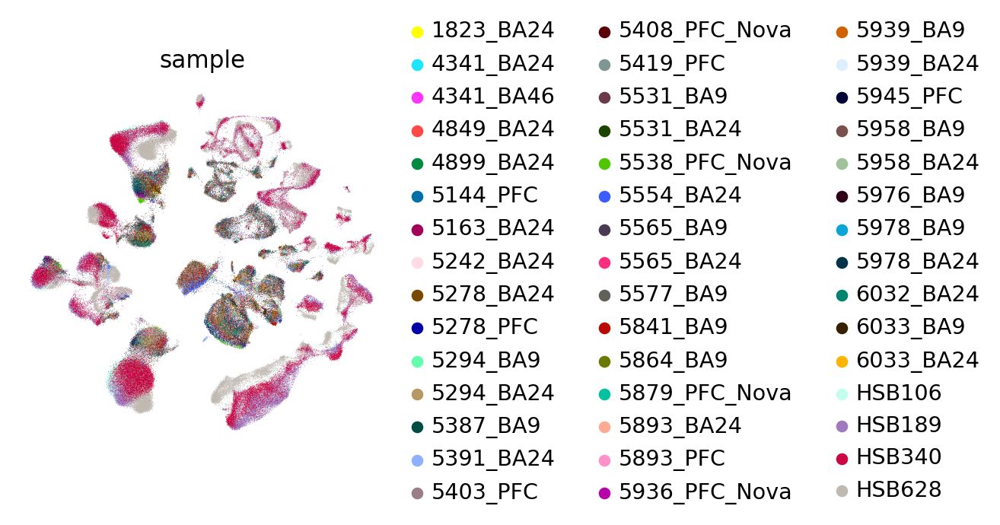

In [74]:
sc.pl.umap(ad1, color=['sample'])

In [81]:
ad1.obs['batch']=ad1.obs['batch'].replace({'0':'Ma et al. Science. 2022.',
                                          '1':'Velmeshev et al. Science. 2019.'})

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


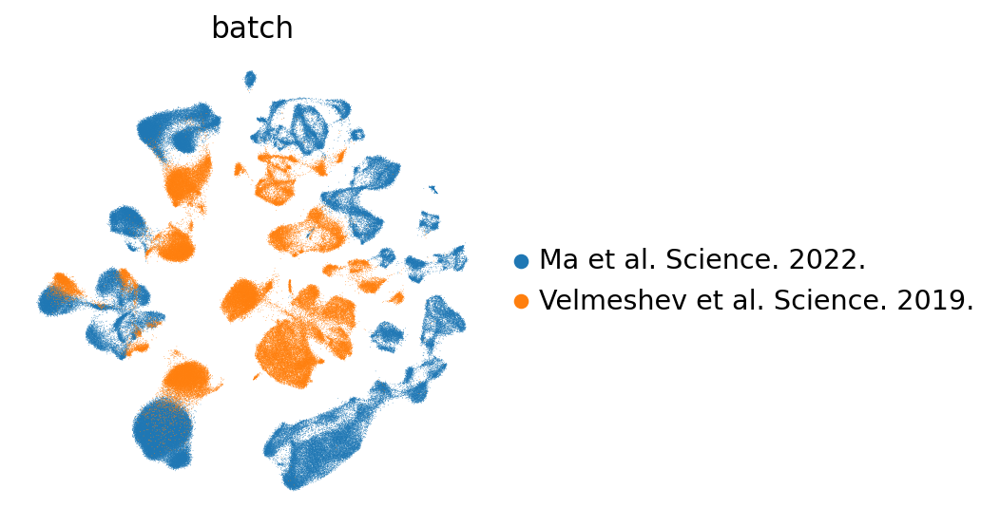

In [82]:
sc.pl.umap(ad1, color=['batch'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


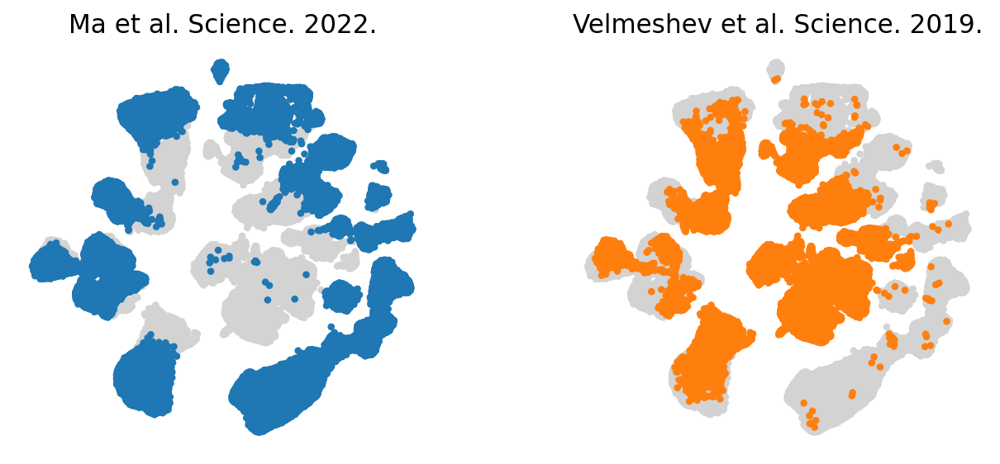

In [83]:
cluster_small_multiples(ad1,'batch')

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


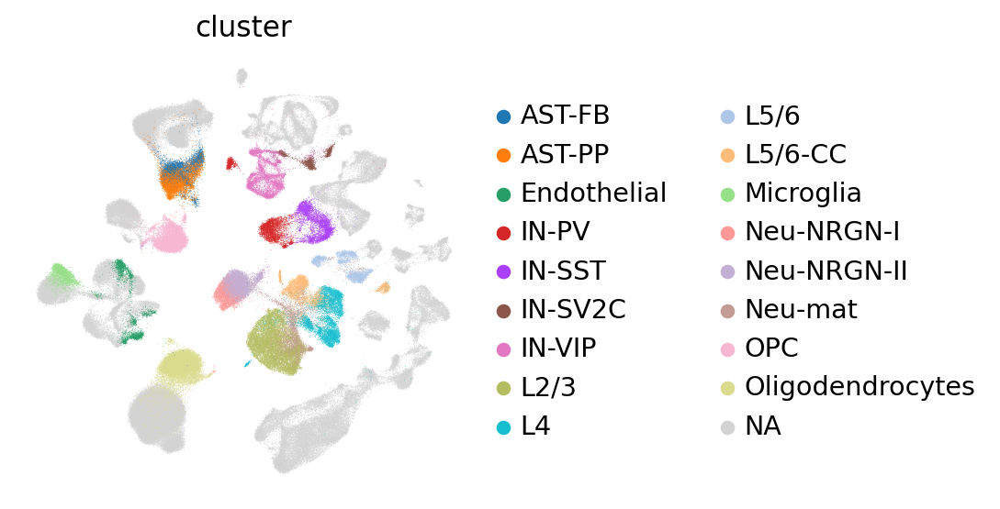

In [76]:
sc.pl.umap(ad1, color=['cluster'])

In [84]:
ad1.obsm['X_umap_raw']=ad1.obsm['X_umap']

In [85]:
sc.external.pp.harmony_integrate(ad1, key = ['batch'])

2023-11-17 14:33:26,335 - harmonypy - INFO - Iteration 1 of 10
INFO:harmonypy:Iteration 1 of 10
2023-11-17 14:36:08,432 - harmonypy - INFO - Iteration 2 of 10
INFO:harmonypy:Iteration 2 of 10
2023-11-17 14:37:57,554 - harmonypy - INFO - Iteration 3 of 10
INFO:harmonypy:Iteration 3 of 10
2023-11-17 14:39:26,521 - harmonypy - INFO - Converged after 3 iterations
INFO:harmonypy:Converged after 3 iterations


In [86]:
sc.pp.neighbors(ad1, use_rep='X_pca_harmony')
sc.tl.umap(ad1)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


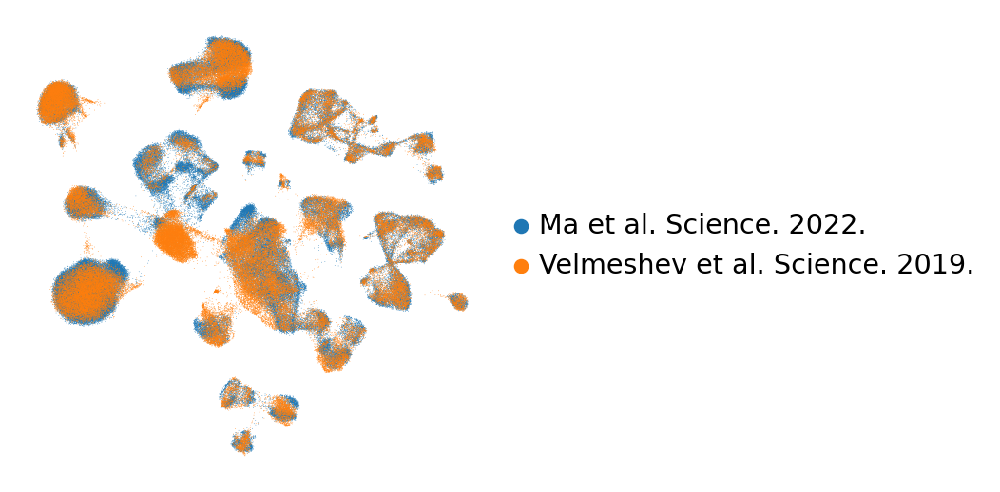

In [91]:
sc.pl.umap(ad1, color=['batch'],title='')

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


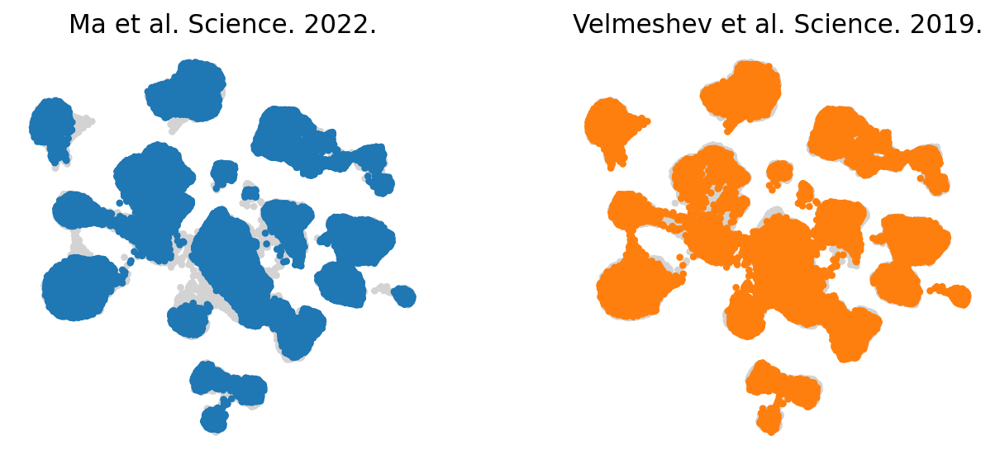

In [90]:
cluster_small_multiples(ad1,'batch')

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


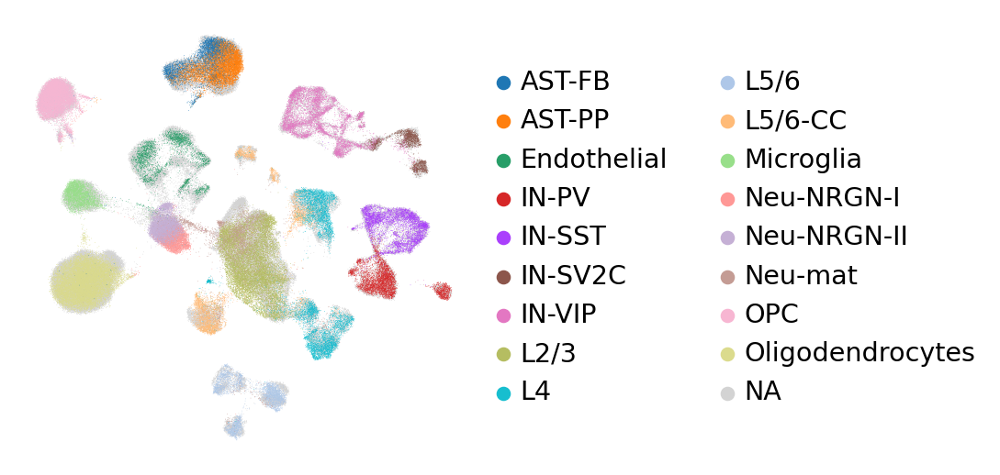

In [92]:
sc.pl.umap(ad1, color=['cluster'],title='')

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


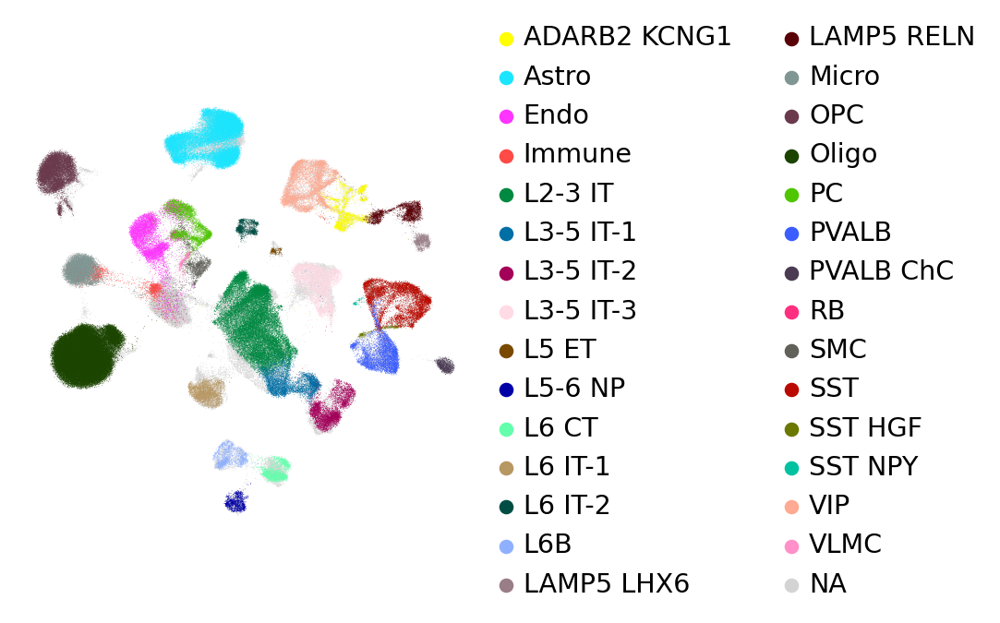

In [93]:
sc.pl.umap(ad1, color=['subclass'],title='')

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


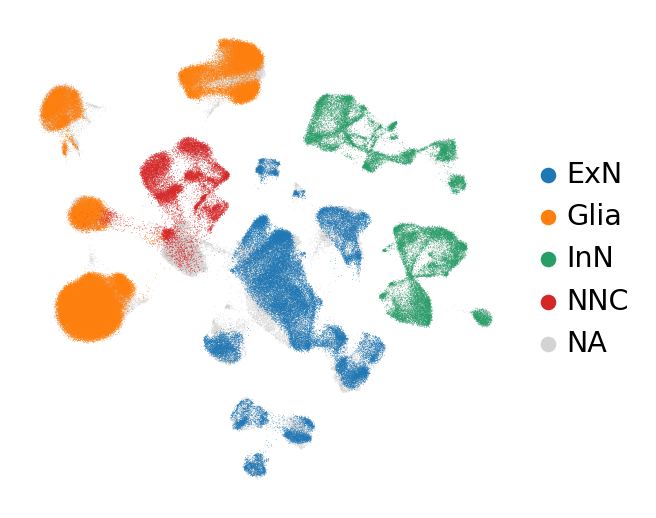

In [99]:
sc.pl.umap(ad1, color=['class'],title='')

In [100]:
sc.tl.louvain(ad1,resolution=0.3)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


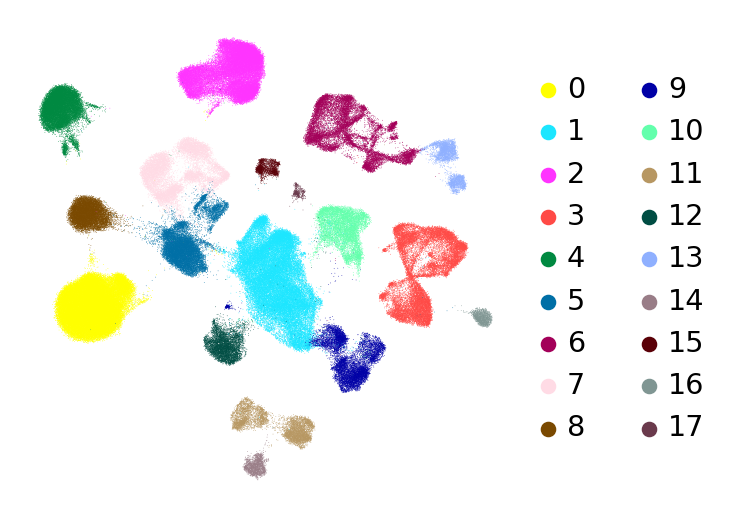

In [101]:
sc.pl.umap(ad1, color=['louvain'],title='')

In [102]:
ad1.write_h5ad('data/integration/raw_count.h5ad')

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping prov

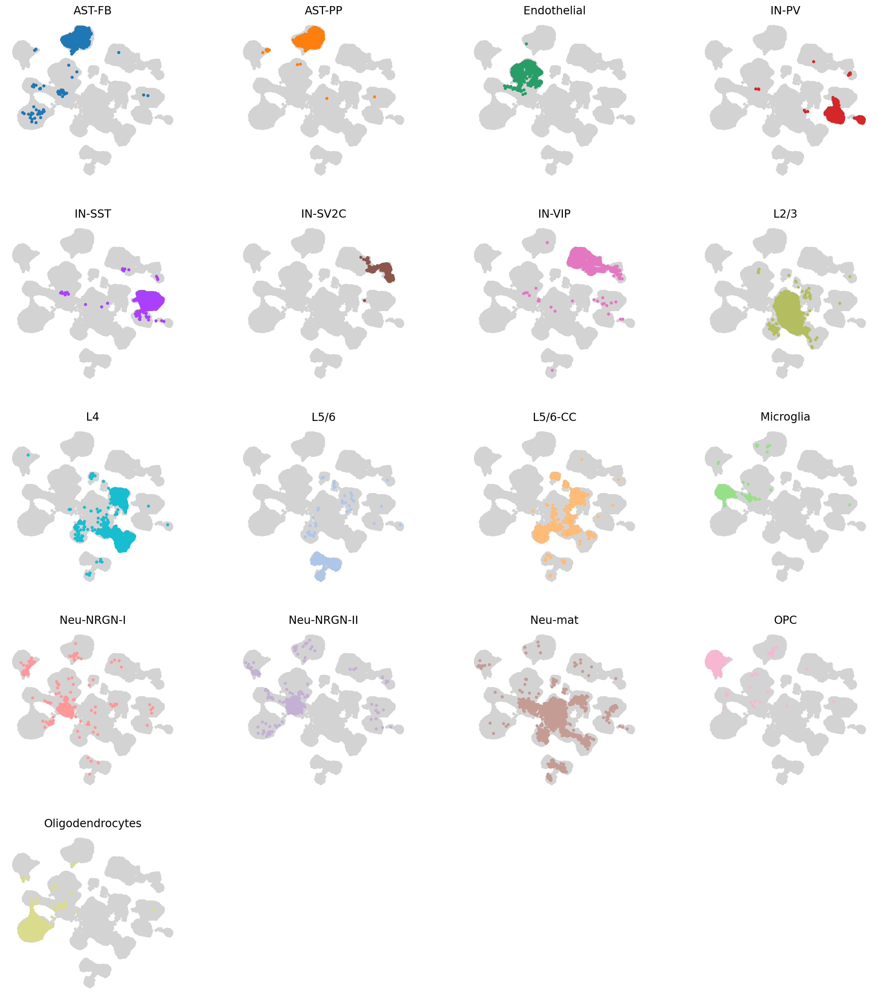

In [103]:
cluster_small_multiples(ad1,'cluster')

In [104]:
ad1=ad1[:,~ad1.var_names.isin(['PC','PVALB','SST','VIP'])]

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping prov

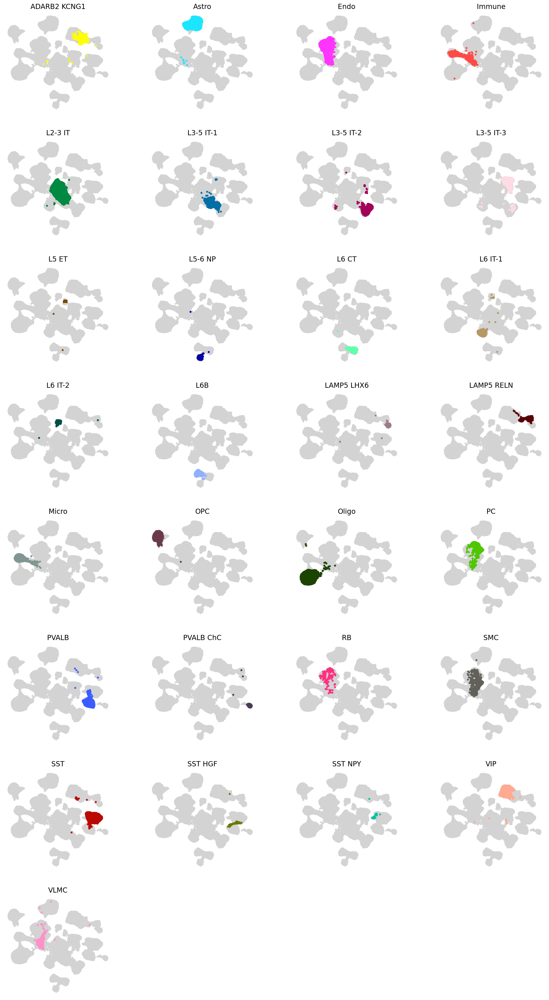

In [105]:
cluster_small_multiples(ad1,'subclass')

# As No processing (raw count)

In [ ]:
ad2=ad.concatenate(autism)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/anndata/_core/anndata.py:1823: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


In [ ]:
ad2

AnnData object with n_obs × n_vars = 276679 × 23063
    obs: 'subtype', 'subclass', 'class', 'samplename', 'tech_rep', 'species', 'sample', 'donor_gender', 'donor_age', 'cell_ID', 'organ', 'project_code', 'reference', 'seq_tech', 'sample_type', 'seq_method', 'treatment', 'region', 'subregion', 'donor_ID', 'original_name', 'original_name2', 'donor_status', 'sample_status', 'if_patient', 'ethnicity', 'sample_ID', 'Siletti_singleCellNet', 'Siletti_SingleR', 'Siletti_scPred', 'Siletti_scMap', 'Siletti_CHETAH', 'Siletti_scArches', 'Siletti_ACTINN', 'Siletti_modf_SCANVI_L1', 'Siletti_modf_SCANVI_L2', 'cell_type', 'cluster', 'individual', 'age', 'sex', 'diagnosis', 'Capbatch', 'Seqbatch', 'post-mortem interval (hours)', 'RNA Integrity Number', 'genes', 'UMIs', 'RNA mitochondr. percent', 'RNA ribosomal percent', 'batch'
    var: 'gene_ids-1', 'gene_names-1'

In [ ]:
ad2.obs

,subtype,subclass,class,samplename,tech_rep,species,sample,donor_gender,donor_age,cell_ID,...,diagnosis,Capbatch,Seqbatch,post-mortem interval (hours),RNA Integrity Number,genes,UMIs,RNA mitochondr. percent,RNA ribosomal percent,batch
HSB106_1_AAACCCAAGAGGCGTT-0,Oligo MOG OPALIN,Oligo,Glia,HSB106,HSB106_1,Homo sapiens,HSB106,M,64yr,HSB106_1_AAACCCAAGAGGCGTT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
HSB106_1_AAACCCAAGGTAGTCG-0,Oligo MOG OPALIN,Oligo,Glia,HSB106,HSB106_1,Homo sapiens,HSB106,M,64yr,HSB106_1_AAACCCAAGGTAGTCG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
HSB106_1_AAACCCAAGGTTATAG-0,Oligo MOG OPALIN,Oligo,Glia,HSB106,HSB106_1,Homo sapiens,HSB106,M,64yr,HSB106_1_AAACCCAAGGTTATAG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
HSB106_1_AAACCCAAGTCGCCCA-0,L3-5 RORB PCBP3 IL1RAPL2,L3-5 IT-1,ExN,HSB106,HSB106_1,Homo sapiens,HSB106,M,64yr,HSB106_1_AAACCCAAGTCGCCCA,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
HSB106_1_AAACCCACAAAGGAGA-0,L2-3 CUX2 ACVR1C THSD7A,L2-3 IT,ExN,HSB106,HSB106_1,Homo sapiens,HSB106,M,64yr,HSB106_1_AAACCCACAAAGGAGA,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCACAAAGTCAA-1_6033_BA9-1,NaN,NaN,NaN,NaN,NaN,NaN,6033_BA9,NaN,NaN,NaN,...,ASD,CB7,SB2,25.0,8.0,4555.0,10514.0,2.805783,1.245958,1
TTTGTCACAAGGCTCC-1_6033_BA9-1,NaN,NaN,NaN,NaN,NaN,NaN,6033_BA9,NaN,NaN,NaN,...,ASD,CB7,SB2,25.0,8.0,913.0,1276.0,0.156740,0.548589,1
TTTGTCAGTCGATTGT-1_6033_BA9-1,NaN,NaN,NaN,NaN,NaN,NaN,6033_BA9,NaN,NaN,NaN,...,ASD,CB7,SB2,25.0,8.0,1807.0,2874.0,0.591510,0.765484,1
TTTGTCATCCCAAGTA-1_6033_BA9-1,NaN,NaN,NaN,NaN,NaN,NaN,6033_BA9,NaN,NaN,NaN,...,ASD,CB7,SB2,25.0,8.0,1451.0,2185.0,1.922197,0.320366,1


In [ ]:
sc.pp.highly_variable_genes(
    ad2,
    flavor="seurat_v3",
    n_top_genes=2000,
    #layer="counts",
    batch_key="sample",
    subset=False
)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:61: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


In [ ]:
ad2.var.highly_variable.sum()

2000

In [ ]:
sc.pp.normalize_total(ad2, target_sum=1e4)
sc.pp.log1p(ad2)

In [ ]:
sc.tl.pca(ad2, svd_solver='arpack', use_highly_variable=True)
sc.pp.neighbors(ad2)
sc.tl.umap(ad2)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


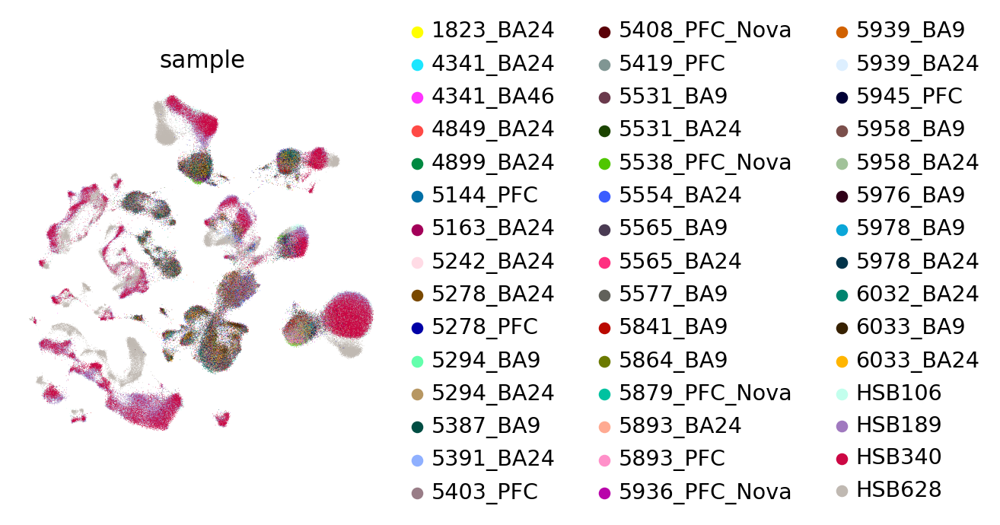

In [ ]:
sc.pl.umap(ad2, color=['sample'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


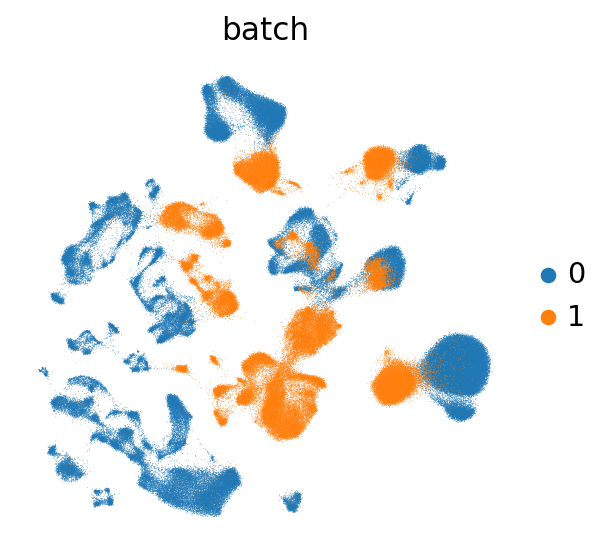

In [ ]:
sc.pl.umap(ad2, color=['batch'])

In [ ]:
sc.external.pp.harmony_integrate(ad2, key = ['sample','batch'])

2023-11-08 10:45:30,213 - harmonypy - INFO - Iteration 1 of 10
2023-11-08 10:50:56,413 - harmonypy - INFO - Iteration 2 of 10
2023-11-08 10:56:05,382 - harmonypy - INFO - Iteration 3 of 10
2023-11-08 10:59:20,684 - harmonypy - INFO - Iteration 4 of 10
2023-11-08 11:01:55,492 - harmonypy - INFO - Converged after 4 iterations


In [ ]:
ad2.obsm['X_umap_raw']=ad2.obsm['X_umap']

In [ ]:
sc.pp.neighbors(ad2, use_rep='X_pca_harmony')
sc.tl.umap(ad2)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


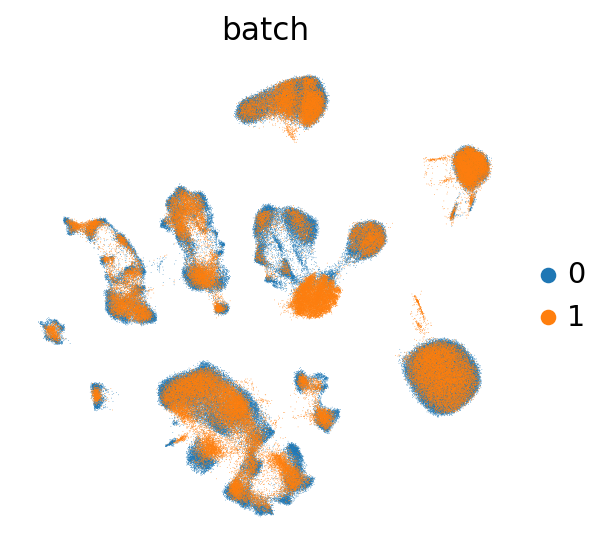

In [ ]:
sc.pl.umap(ad2, color=['batch'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


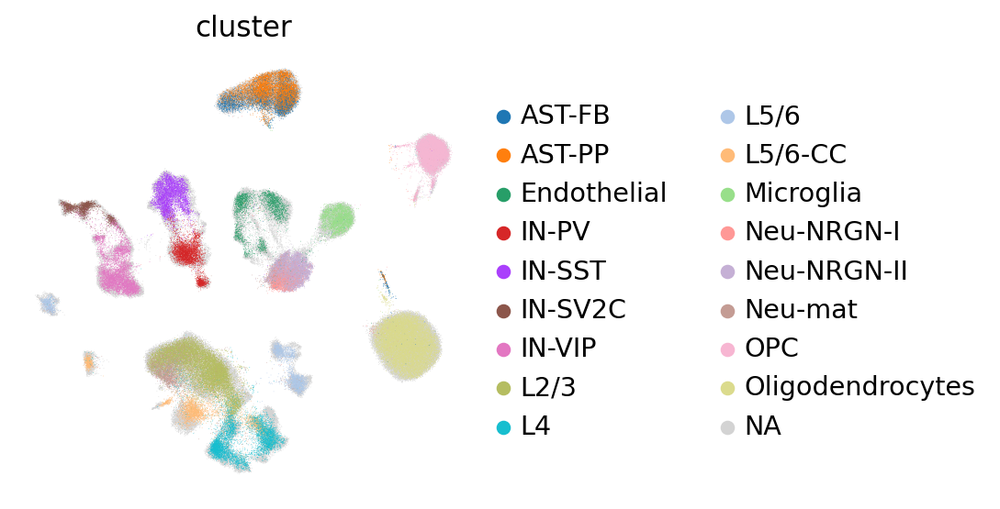

In [ ]:
sc.pl.umap(ad2, color=['cluster'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


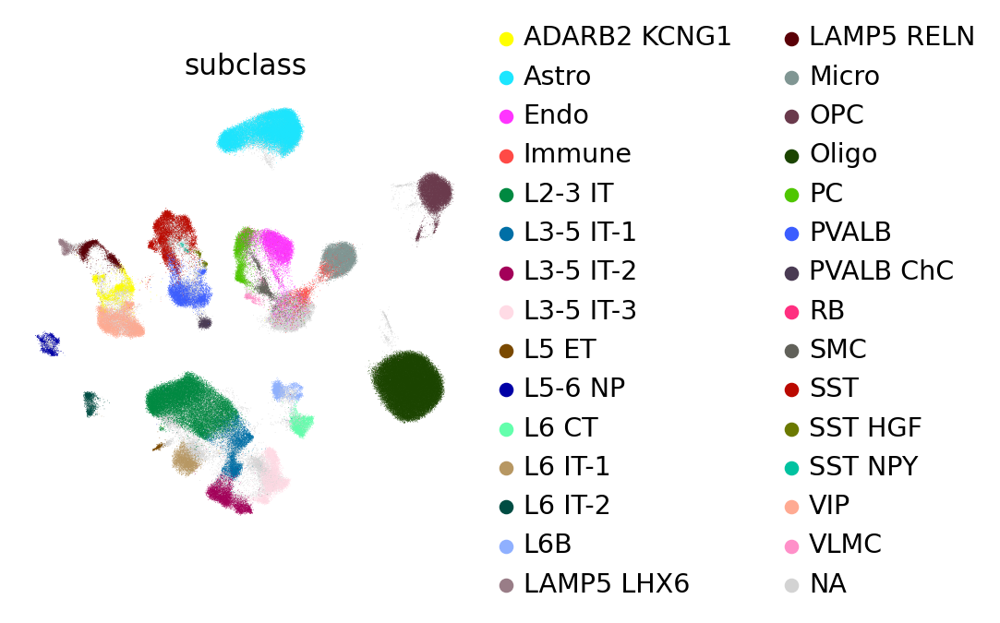

In [ ]:
sc.pl.umap(ad2, color=['subclass'])

In [ ]:
ad2.write_h5ad('data/integration/as_raw_count.h5ad')

In [ ]:
sc.external.pp.harmony_integrate(ad2, key = [aa'batch'])

2023-11-08 11:24:56,297 - harmonypy - INFO - Iteration 1 of 10
2023-11-08 11:28:40,645 - harmonypy - INFO - Iteration 2 of 10
2023-11-08 11:32:39,009 - harmonypy - INFO - Iteration 3 of 10
2023-11-08 11:34:28,902 - harmonypy - INFO - Iteration 4 of 10
2023-11-08 11:35:59,107 - harmonypy - INFO - Converged after 4 iterations


In [ ]:
ad2.obsm['X_umap_1']=ad2.obsm['X_umap']

In [ ]:
sc.pp.neighbors(ad2, use_rep='X_pca_harmony')
sc.tl.umap(ad2)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


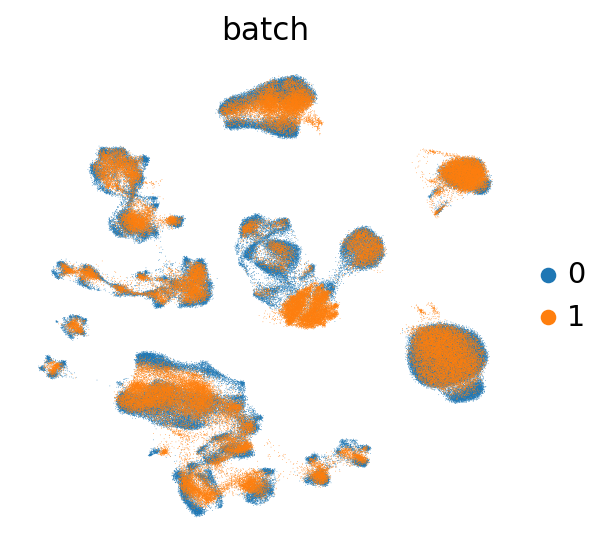

In [ ]:
sc.pl.umap(ad2, color=['batch'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


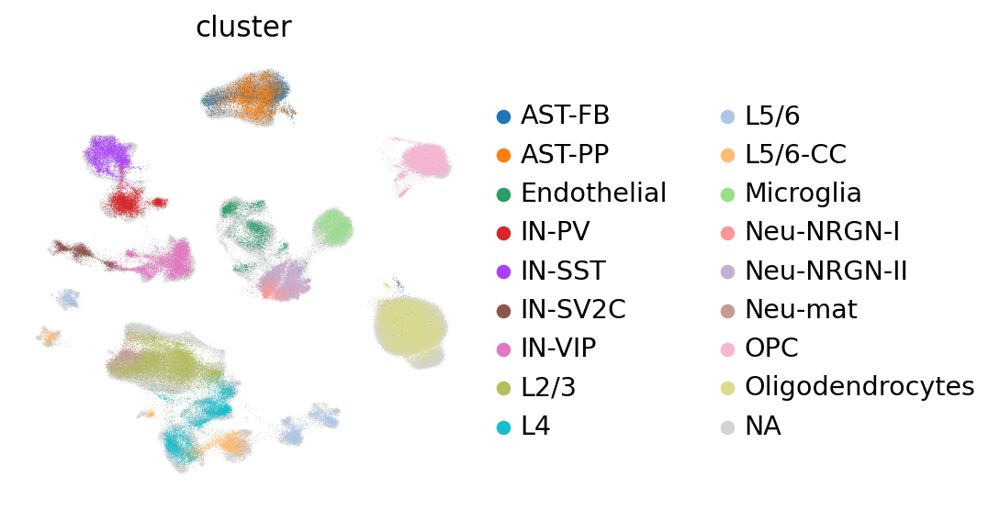

In [ ]:
sc.pl.umap(ad2, color=['cluster'])

In [ ]:
ad2.obs['class']

HSB106_1_AAACCCAAGAGGCGTT-0      Glia
HSB106_1_AAACCCAAGGTAGTCG-0      Glia
HSB106_1_AAACCCAAGGTTATAG-0      Glia
HSB106_1_AAACCCAAGTCGCCCA-0       ExN
HSB106_1_AAACCCACAAAGGAGA-0       ExN
                                 ... 
TTTGTCACAAAGTCAA-1_6033_BA9-1     NaN
TTTGTCACAAGGCTCC-1_6033_BA9-1     NaN
TTTGTCAGTCGATTGT-1_6033_BA9-1     NaN
TTTGTCATCCCAAGTA-1_6033_BA9-1     NaN
TTTGTCATCGTTACGA-1_6033_BA9-1     NaN
Name: class, Length: 276679, dtype: category
Categories (4, object): ['ExN', 'Glia', 'InN', 'NNC']

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


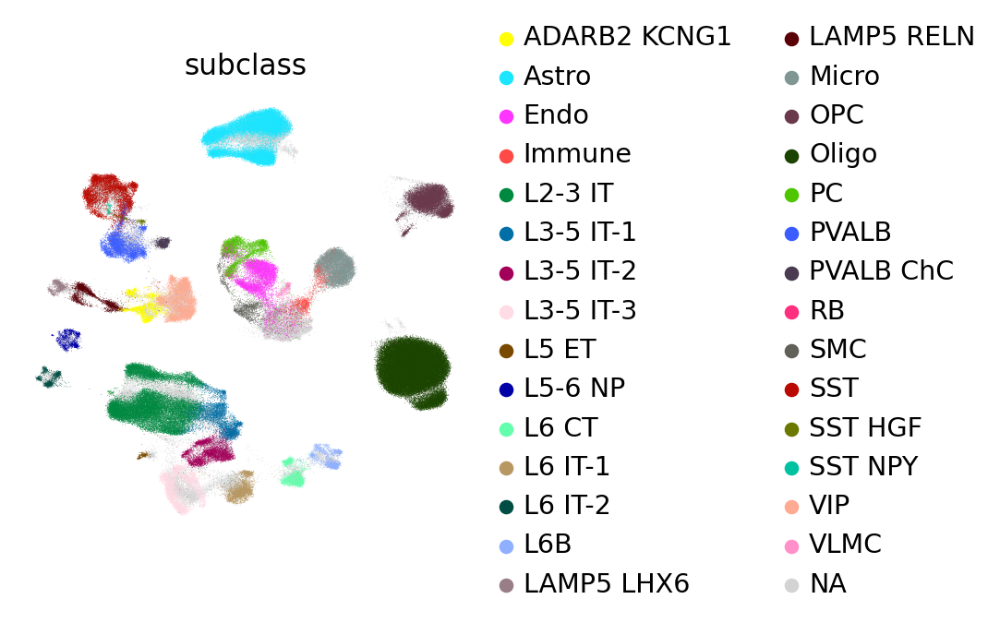

In [ ]:
sc.pl.umap(ad2, color=['subclass'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping prov

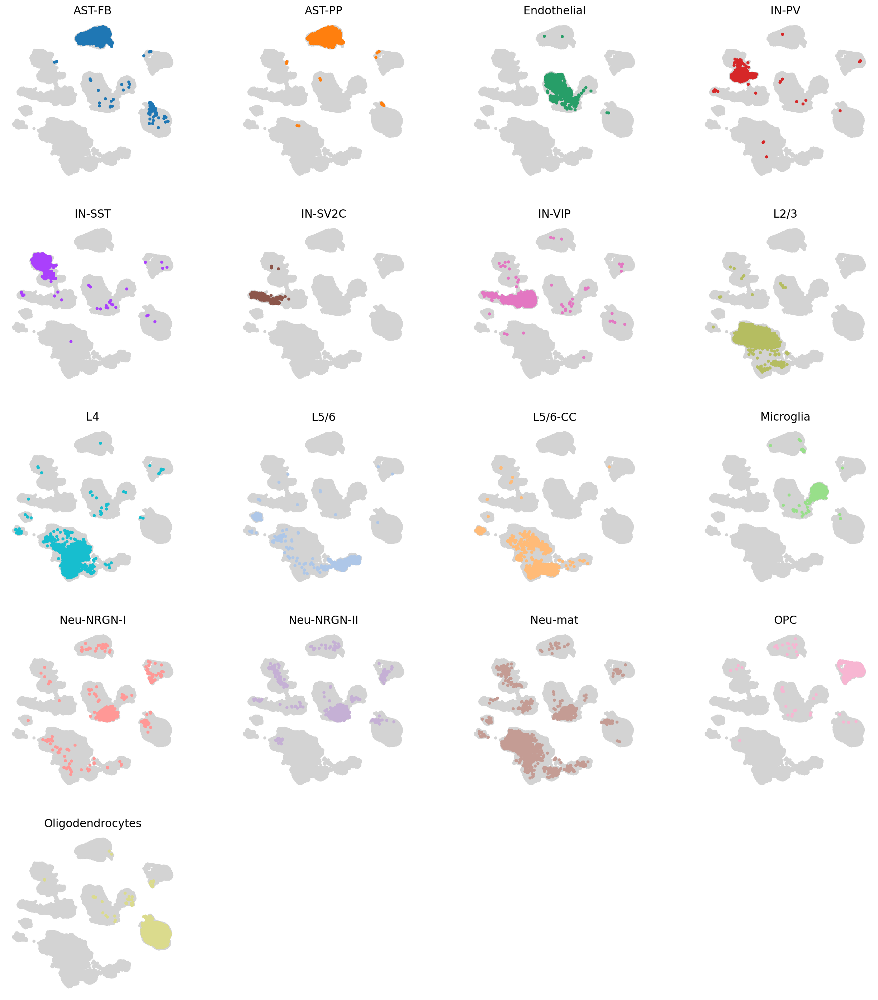

In [ ]:
cluster_small_multiples(ad2,'cluster')

In [ ]:
ad2=ad2[:,~ad2.var_names.isin(['PC','PVALB','SST','VIP'])]

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping prov

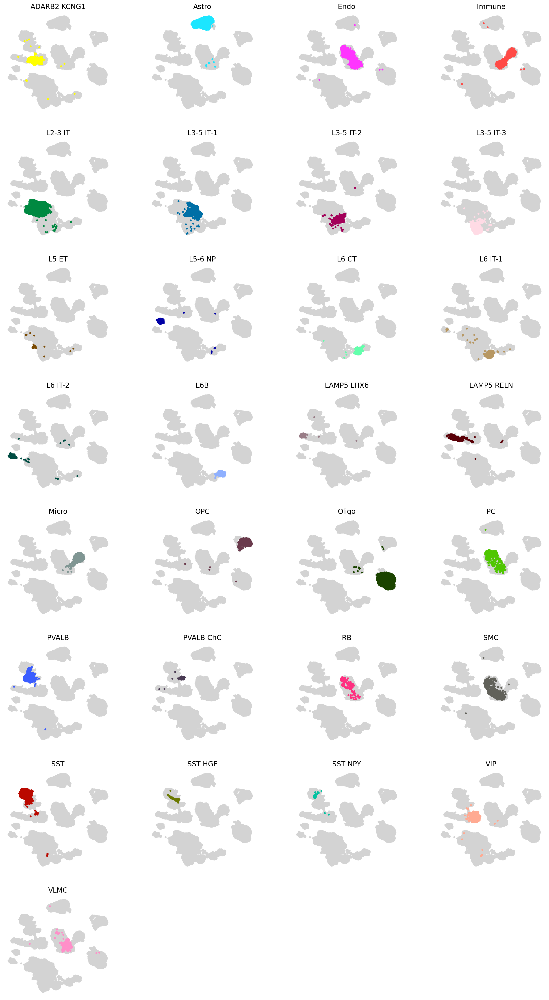

In [ ]:
cluster_small_multiples(ad2,'subclass')

In [ ]:
ad2.write_h5ad('data/integration/as_raw_count.h5ad')

# As normlized data (1e4)

In [ ]:
sc.pp.normalize_total(ad, target_sum=1e4)
sc.pp.log1p(ad)

In [ ]:
ad.X.data

array([2.1901448, 2.1901448, 3.4887817, ..., 2.6776004, 2.6776004,
       2.6776004], dtype=float32)

In [ ]:
ad3=ad.concatenate(autism)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/anndata/_core/anndata.py:1823: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


In [ ]:
ad3

AnnData object with n_obs × n_vars = 276679 × 23063
    obs: 'subtype', 'subclass', 'class', 'samplename', 'tech_rep', 'species', 'sample', 'donor_gender', 'donor_age', 'cell_ID', 'organ', 'project_code', 'reference', 'seq_tech', 'sample_type', 'seq_method', 'treatment', 'region', 'subregion', 'donor_ID', 'original_name', 'original_name2', 'donor_status', 'sample_status', 'if_patient', 'ethnicity', 'sample_ID', 'Siletti_singleCellNet', 'Siletti_SingleR', 'Siletti_scPred', 'Siletti_scMap', 'Siletti_CHETAH', 'Siletti_scArches', 'Siletti_ACTINN', 'Siletti_modf_SCANVI_L1', 'Siletti_modf_SCANVI_L2', 'cell_type', 'cluster', 'individual', 'age', 'sex', 'diagnosis', 'Capbatch', 'Seqbatch', 'post-mortem interval (hours)', 'RNA Integrity Number', 'genes', 'UMIs', 'RNA mitochondr. percent', 'RNA ribosomal percent', 'batch'
    var: 'gene_ids-1', 'gene_names-1'

In [ ]:
ad3.obs

,subtype,subclass,class,samplename,tech_rep,species,sample,donor_gender,donor_age,cell_ID,...,diagnosis,Capbatch,Seqbatch,post-mortem interval (hours),RNA Integrity Number,genes,UMIs,RNA mitochondr. percent,RNA ribosomal percent,batch
HSB106_1_AAACCCAAGAGGCGTT-0,Oligo MOG OPALIN,Oligo,Glia,HSB106,HSB106_1,Homo sapiens,HSB106,M,64yr,HSB106_1_AAACCCAAGAGGCGTT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
HSB106_1_AAACCCAAGGTAGTCG-0,Oligo MOG OPALIN,Oligo,Glia,HSB106,HSB106_1,Homo sapiens,HSB106,M,64yr,HSB106_1_AAACCCAAGGTAGTCG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
HSB106_1_AAACCCAAGGTTATAG-0,Oligo MOG OPALIN,Oligo,Glia,HSB106,HSB106_1,Homo sapiens,HSB106,M,64yr,HSB106_1_AAACCCAAGGTTATAG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
HSB106_1_AAACCCAAGTCGCCCA-0,L3-5 RORB PCBP3 IL1RAPL2,L3-5 IT-1,ExN,HSB106,HSB106_1,Homo sapiens,HSB106,M,64yr,HSB106_1_AAACCCAAGTCGCCCA,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
HSB106_1_AAACCCACAAAGGAGA-0,L2-3 CUX2 ACVR1C THSD7A,L2-3 IT,ExN,HSB106,HSB106_1,Homo sapiens,HSB106,M,64yr,HSB106_1_AAACCCACAAAGGAGA,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCACAAAGTCAA-1_6033_BA9-1,NaN,NaN,NaN,NaN,NaN,NaN,6033_BA9,NaN,NaN,NaN,...,ASD,CB7,SB2,25.0,8.0,4555.0,10514.0,2.805783,1.245958,1
TTTGTCACAAGGCTCC-1_6033_BA9-1,NaN,NaN,NaN,NaN,NaN,NaN,6033_BA9,NaN,NaN,NaN,...,ASD,CB7,SB2,25.0,8.0,913.0,1276.0,0.156740,0.548589,1
TTTGTCAGTCGATTGT-1_6033_BA9-1,NaN,NaN,NaN,NaN,NaN,NaN,6033_BA9,NaN,NaN,NaN,...,ASD,CB7,SB2,25.0,8.0,1807.0,2874.0,0.591510,0.765484,1
TTTGTCATCCCAAGTA-1_6033_BA9-1,NaN,NaN,NaN,NaN,NaN,NaN,6033_BA9,NaN,NaN,NaN,...,ASD,CB7,SB2,25.0,8.0,1451.0,2185.0,1.922197,0.320366,1


In [ ]:
sc.pp.highly_variable_genes(ad3, min_mean=0.0125, max_mean=3, min_disp=0.5, batch_key = 'sample')

... storing 'cell_ID' as categorical


In [ ]:
ad3.var.highly_variable.sum()

4527

In [ ]:
sc.tl.pca(ad3, svd_solver='arpack', use_highly_variable=True)
sc.pp.neighbors(ad3)
sc.tl.umap(ad3)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


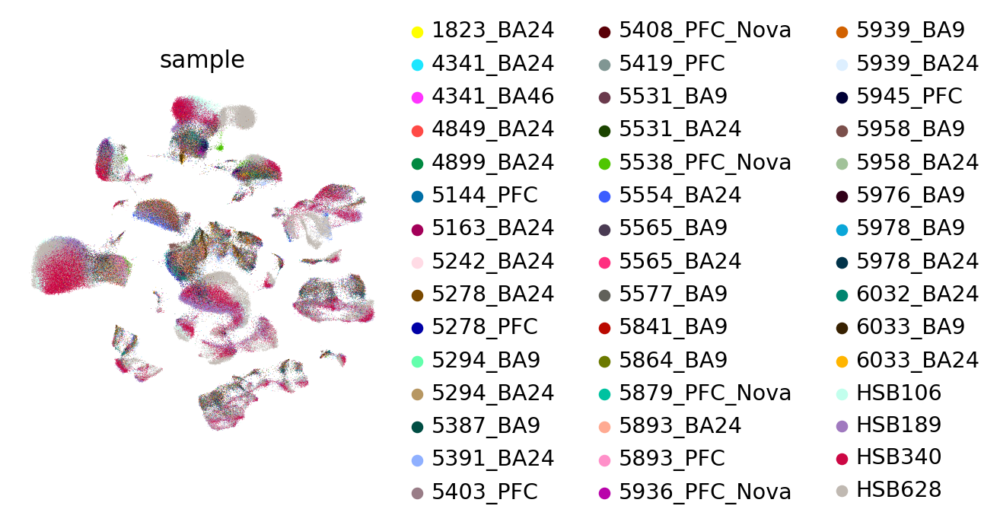

In [ ]:
sc.pl.umap(ad3, color=['sample'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


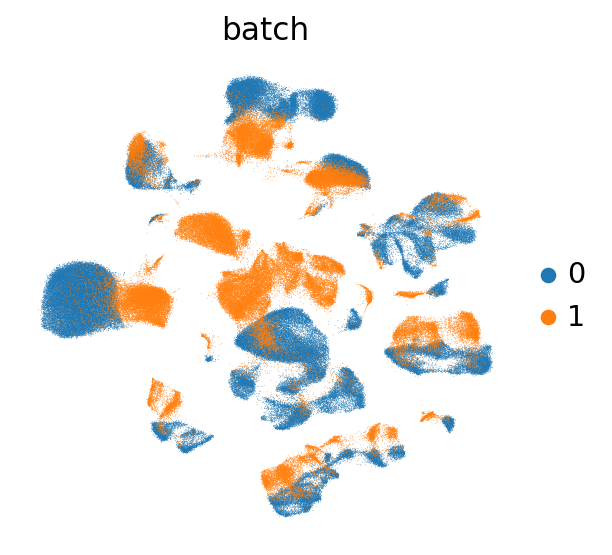

In [ ]:
sc.pl.umap(ad3, color=['batch'])

In [ ]:
sc.external.pp.harmony_integrate(ad3, key = ['sample','batch'])

2023-11-08 14:44:19,157 - harmonypy - INFO - Iteration 1 of 10
2023-11-08 14:48:33,784 - harmonypy - INFO - Iteration 2 of 10
2023-11-08 14:52:47,613 - harmonypy - INFO - Iteration 3 of 10
2023-11-08 14:57:00,174 - harmonypy - INFO - Iteration 4 of 10
2023-11-08 15:01:10,878 - harmonypy - INFO - Iteration 5 of 10
2023-11-08 15:03:04,050 - harmonypy - INFO - Iteration 6 of 10
2023-11-08 15:04:59,954 - harmonypy - INFO - Iteration 7 of 10
2023-11-08 15:06:44,565 - harmonypy - INFO - Iteration 8 of 10
2023-11-08 15:08:37,298 - harmonypy - INFO - Iteration 9 of 10
2023-11-08 15:10:35,389 - harmonypy - INFO - Iteration 10 of 10
2023-11-08 15:12:25,651 - harmonypy - INFO - Stopped before convergence


In [ ]:
ad3.obsm['X_umap_raw']=ad3.obsm['X_umap']

In [ ]:
sc.pp.neighbors(ad3, use_rep='X_pca_harmony')
sc.tl.umap(ad3)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


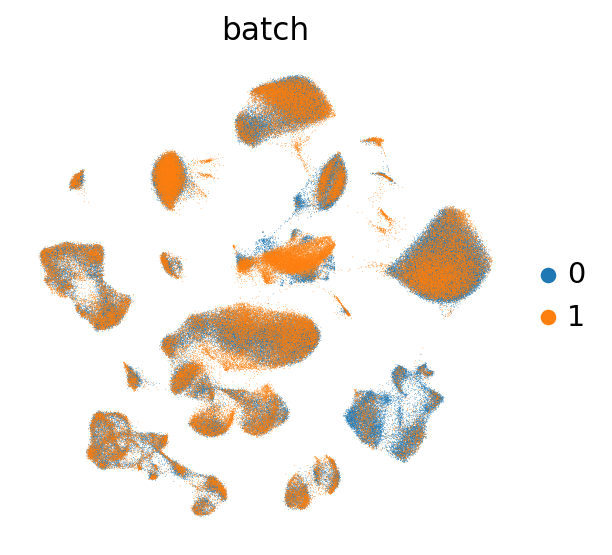

In [ ]:
sc.pl.umap(ad3, color=['batch'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


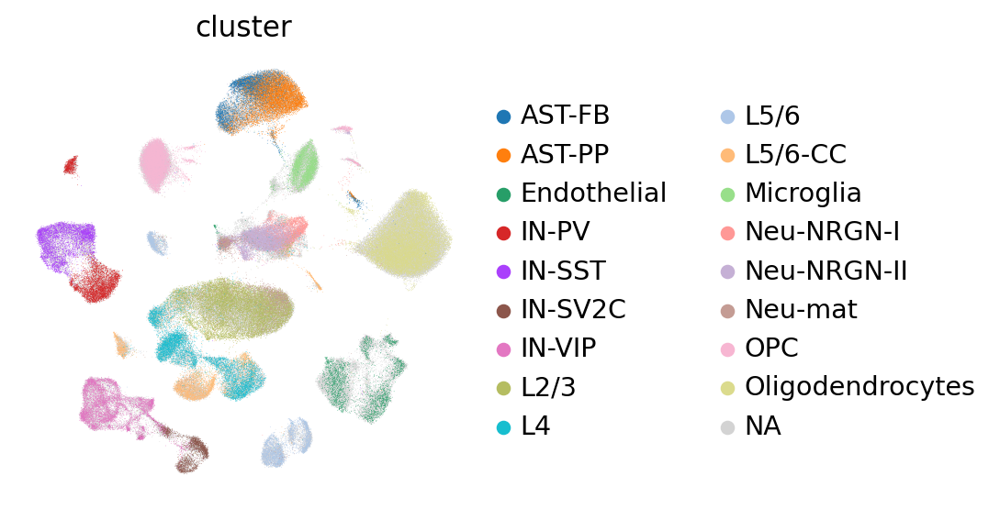

In [ ]:
sc.pl.umap(ad3, color=['cluster'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


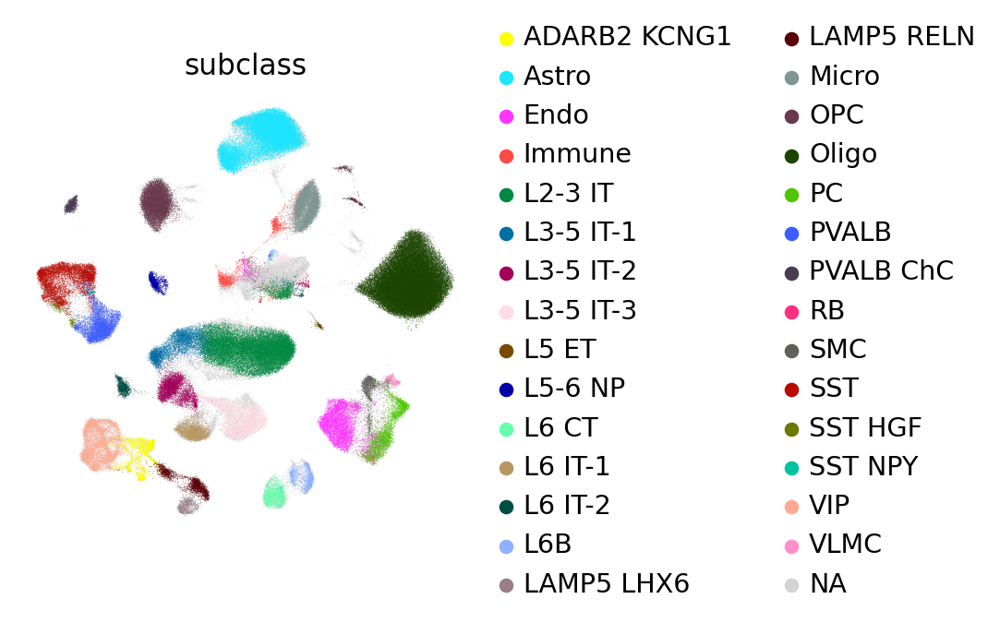

In [ ]:
sc.pl.umap(ad3, color=['subclass'])

In [ ]:
ad3.write_h5ad('data/integration/as_normlized_data.h5ad')

In [ ]:
sc.external.pp.harmony_integrate(ad3, key = ['batch'])

2023-11-08 15:38:19,525 - harmonypy - INFO - Iteration 1 of 10
2023-11-08 15:41:37,563 - harmonypy - INFO - Iteration 2 of 10
2023-11-08 15:44:53,763 - harmonypy - INFO - Iteration 3 of 10
2023-11-08 15:47:15,995 - harmonypy - INFO - Iteration 4 of 10
2023-11-08 15:48:34,496 - harmonypy - INFO - Iteration 5 of 10
2023-11-08 15:49:42,313 - harmonypy - INFO - Iteration 6 of 10
2023-11-08 15:50:50,912 - harmonypy - INFO - Iteration 7 of 10
2023-11-08 15:52:00,161 - harmonypy - INFO - Iteration 8 of 10
2023-11-08 15:53:09,867 - harmonypy - INFO - Iteration 9 of 10
2023-11-08 15:54:19,286 - harmonypy - INFO - Iteration 10 of 10
2023-11-08 15:55:17,533 - harmonypy - INFO - Stopped before convergence


In [ ]:
ad3.obsm['X_umap_1']=ad3.obsm['X_umap']

In [ ]:
sc.pp.neighbors(ad3, use_rep='X_pca_harmony')
sc.tl.umap(ad3)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


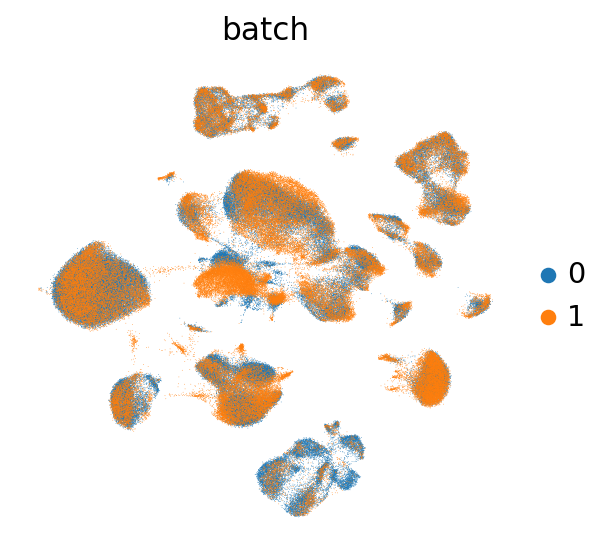

In [ ]:
sc.pl.umap(ad3, color=['batch'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


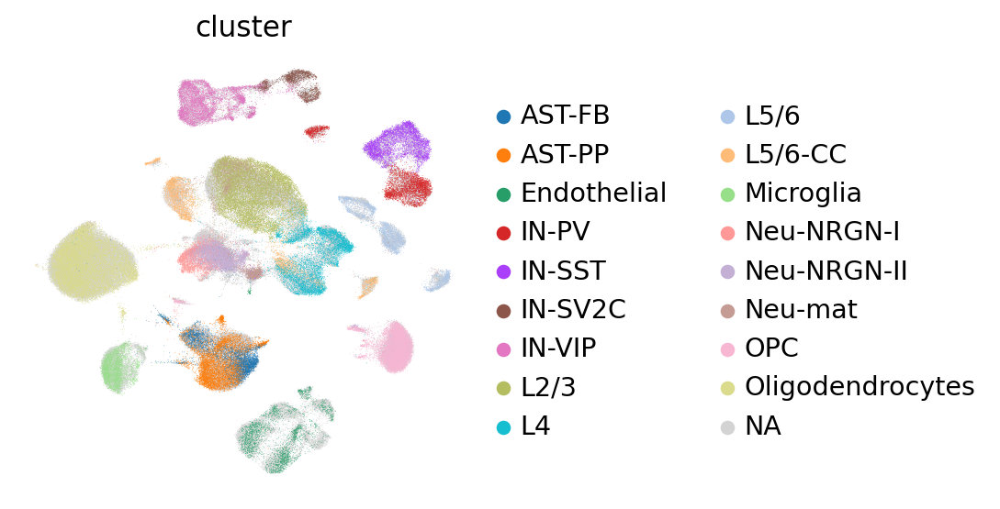

In [ ]:
sc.pl.umap(ad3, color=['cluster'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


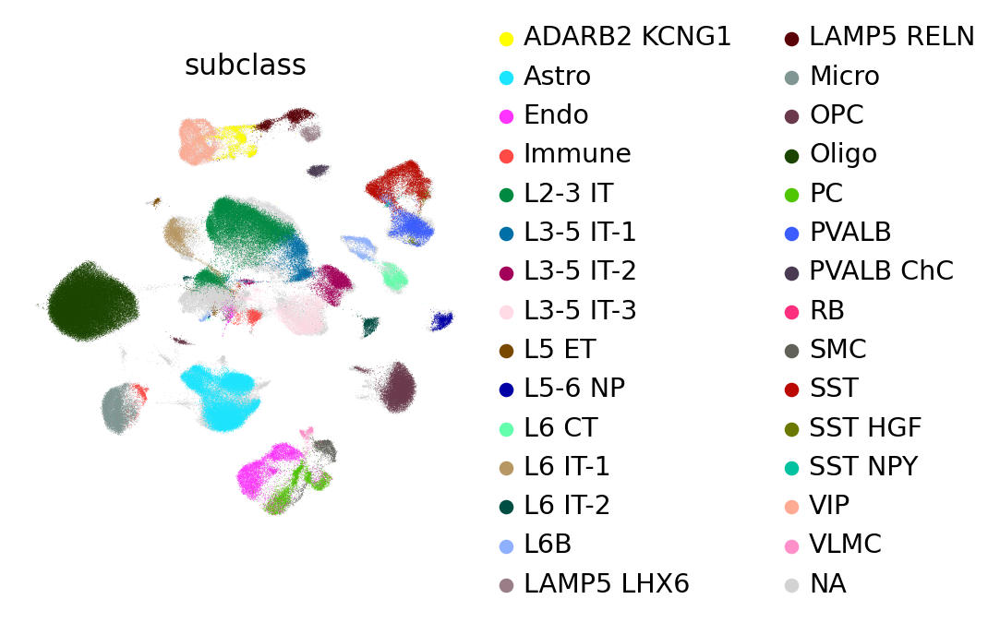

In [ ]:
sc.pl.umap(ad3, color=['subclass'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping prov

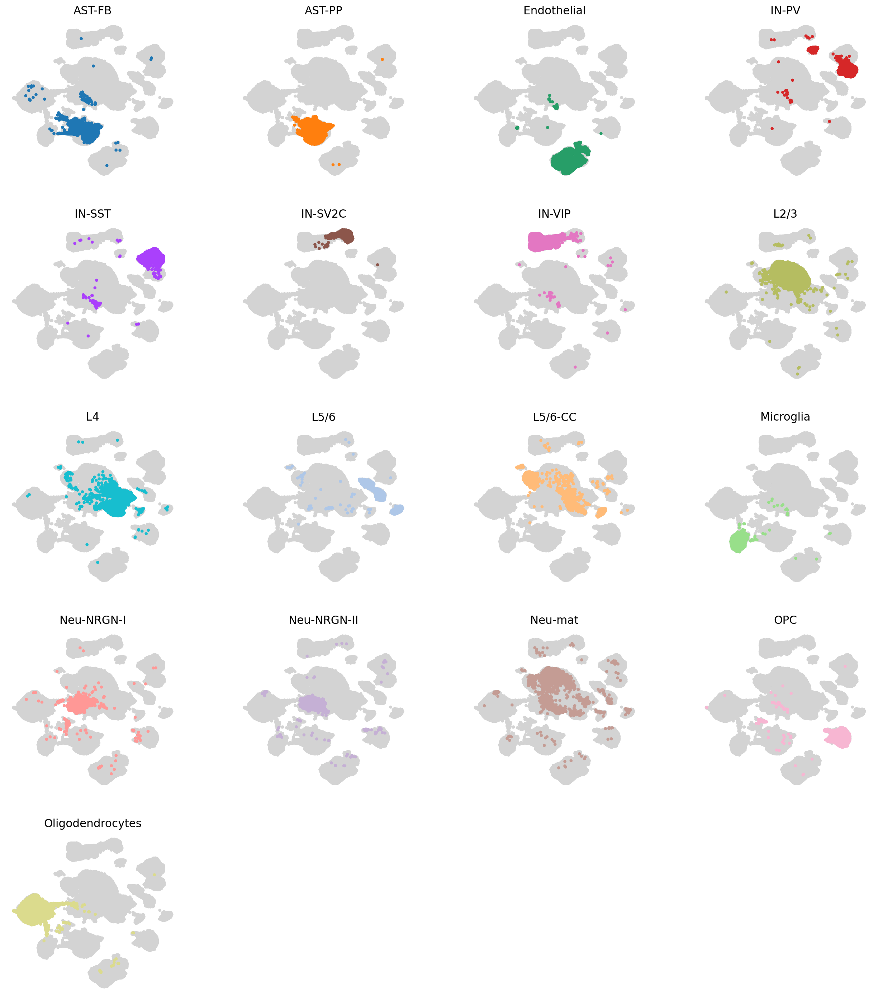

In [ ]:
cluster_small_multiples(ad3,'cluster')

In [ ]:
ad3=ad3[:,~ad3.var_names.isin(['PC','PVALB','SST','VIP'])]

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping prov

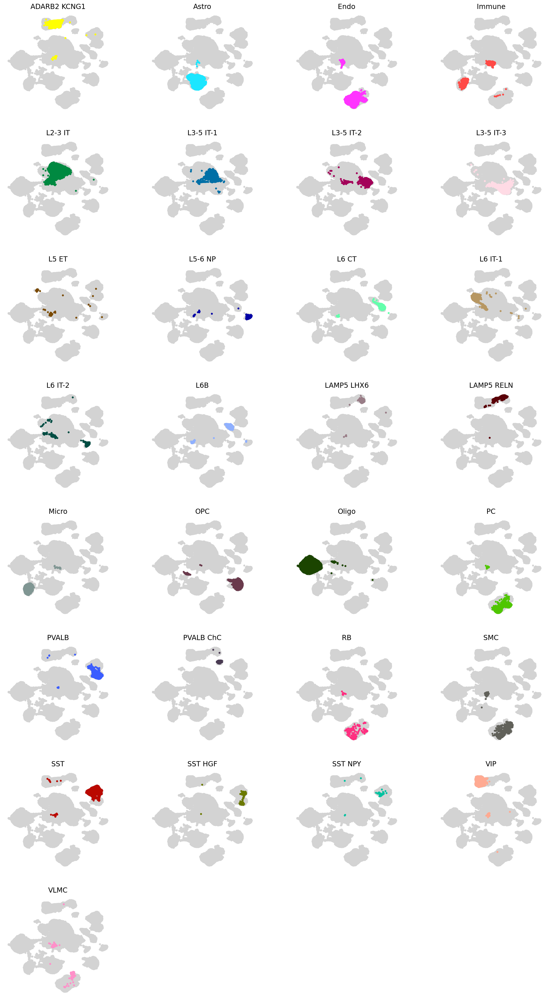

In [ ]:
cluster_small_multiples(ad3,'subclass')

In [ ]:
ad3.write_h5ad('data/integration/as_normlized_data.h5ad')

# As normlized data (1e6)

In [ ]:
ad.X=ad.layers['counts'].copy()

In [ ]:
ad.X.data

array([1., 1., 4., ..., 1., 1., 1.], dtype=float32)

In [ ]:
sc.pp.normalize_total(ad, target_sum=1e6)
sc.pp.log1p(ad)

In [ ]:
ad.X.data

array([6.6779027, 6.6779027, 8.063252 , ..., 7.2123046, 7.2123046,
       7.2123046], dtype=float32)

In [ ]:
ad3=ad.concatenate(autism)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/anndata/_core/anndata.py:1823: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


In [ ]:
ad3

AnnData object with n_obs × n_vars = 276679 × 23063
    obs: 'subtype', 'subclass', 'class', 'samplename', 'tech_rep', 'species', 'sample', 'donor_gender', 'donor_age', 'cell_ID', 'organ', 'project_code', 'reference', 'seq_tech', 'sample_type', 'seq_method', 'treatment', 'region', 'subregion', 'donor_ID', 'original_name', 'original_name2', 'donor_status', 'sample_status', 'if_patient', 'ethnicity', 'sample_ID', 'Siletti_singleCellNet', 'Siletti_SingleR', 'Siletti_scPred', 'Siletti_scMap', 'Siletti_CHETAH', 'Siletti_scArches', 'Siletti_ACTINN', 'Siletti_modf_SCANVI_L1', 'Siletti_modf_SCANVI_L2', 'cell_type', 'cluster', 'individual', 'age', 'sex', 'diagnosis', 'Capbatch', 'Seqbatch', 'post-mortem interval (hours)', 'RNA Integrity Number', 'genes', 'UMIs', 'RNA mitochondr. percent', 'RNA ribosomal percent', 'batch'
    var: 'gene_ids-1', 'gene_names-1'

In [ ]:
sc.pp.highly_variable_genes(
    ad3,
    n_top_genes=2000,
    batch_key='sample',
    subset=False)

... storing 'cell_ID' as categorical


In [ ]:
ad3.var.highly_variable.sum()

2000

In [ ]:
sc.tl.pca(ad3, svd_solver='arpack', use_highly_variable=True)
sc.pp.neighbors(ad3)
sc.tl.umap(ad3)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


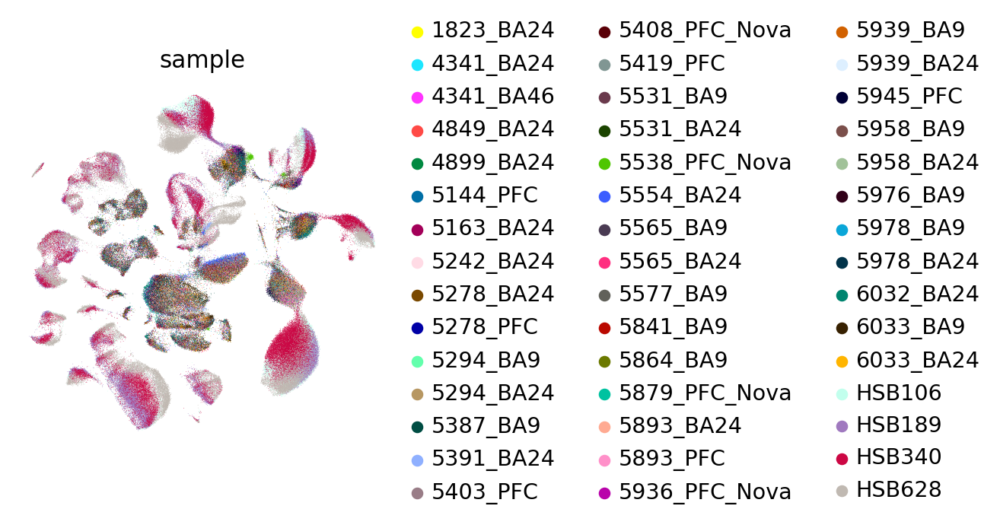

In [ ]:
sc.pl.umap(ad3, color=['sample'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


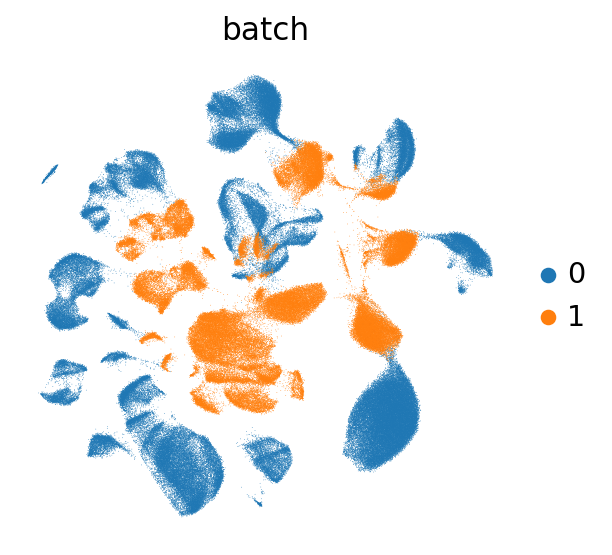

In [ ]:
sc.pl.umap(ad3, color=['batch'])

In [ ]:
ad3.obsm['X_umap_raw']=ad3.obsm['X_umap']

In [ ]:
sc.external.pp.harmony_integrate(ad3, key = ['batch'])

2023-11-08 16:45:37,316 - harmonypy - INFO - Iteration 1 of 10
2023-11-08 16:48:44,637 - harmonypy - INFO - Iteration 2 of 10
2023-11-08 16:51:48,809 - harmonypy - INFO - Converged after 2 iterations


In [ ]:
ad3.obsm['X_umap_1']=ad3.obsm['X_umap']

In [ ]:
sc.pp.neighbors(ad3, use_rep='X_pca_harmony')
sc.tl.umap(ad3)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


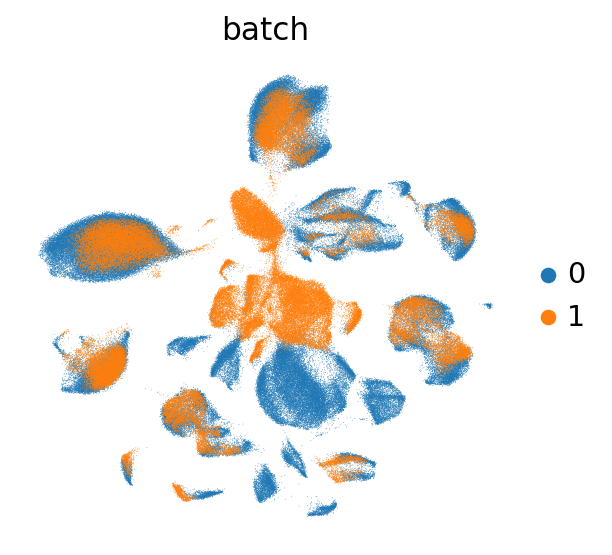

In [ ]:
sc.pl.umap(ad3, color=['batch'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


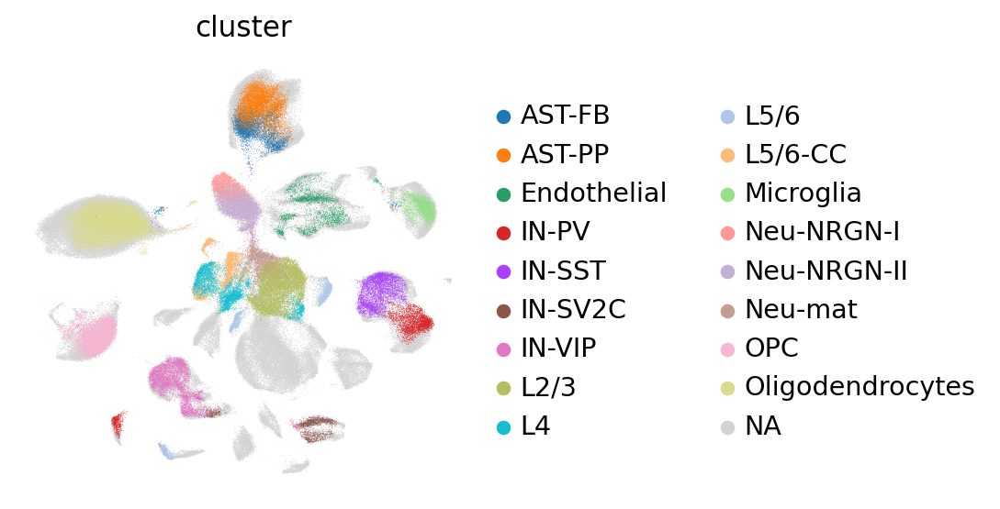

In [ ]:
sc.pl.umap(ad3, color=['cluster'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


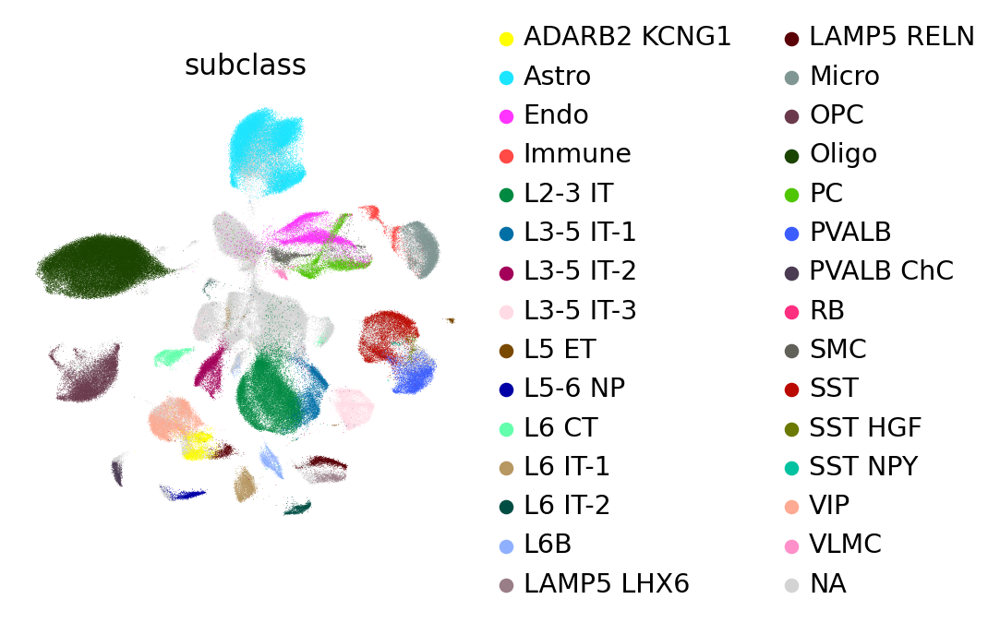

In [ ]:
sc.pl.umap(ad3, color=['subclass'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping prov

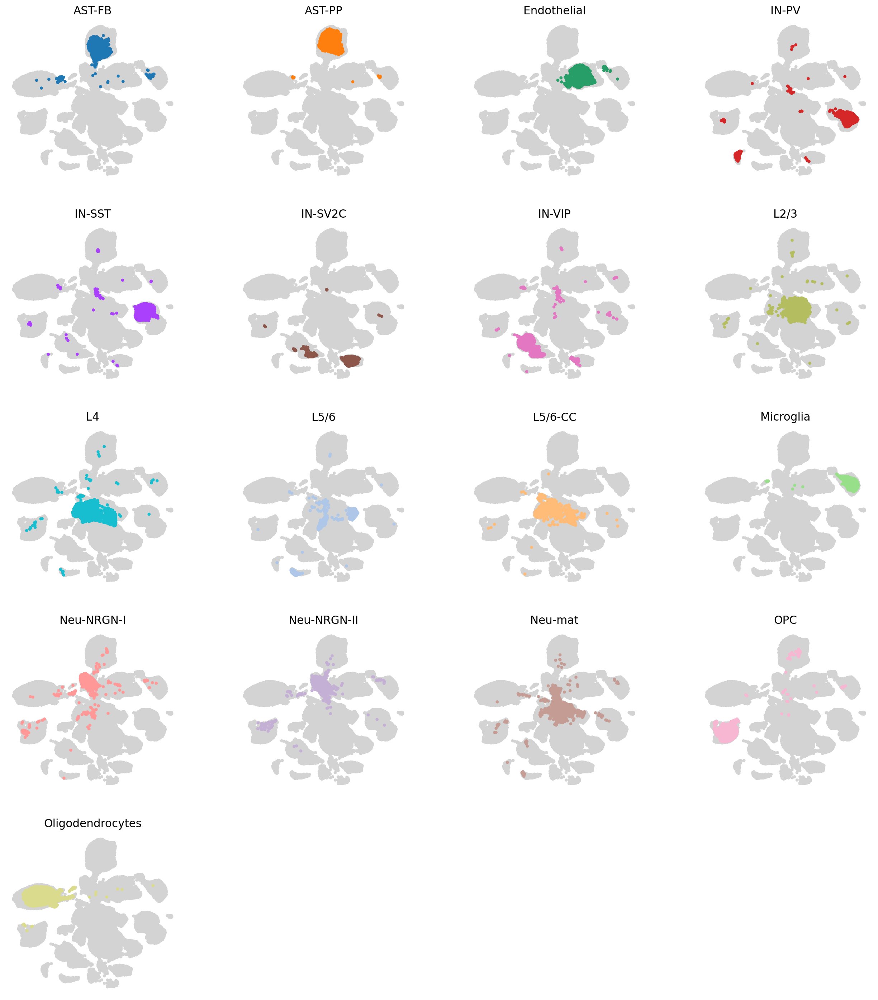

In [ ]:
cluster_small_multiples(ad3,'cluster')

In [ ]:
ad3=ad3[:,~ad3.var_names.isin(['PC','PVALB','SST','VIP'])]

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping prov

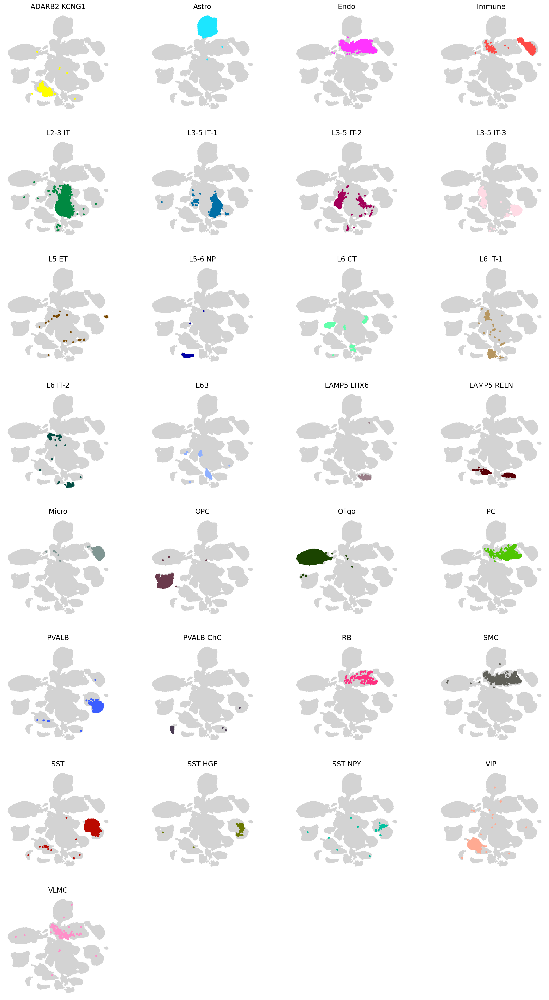

In [ ]:
cluster_small_multiples(ad3,'subclass')

In [ ]:
ad3.write_h5ad('data/integration/as_normlized_data_1e6.h5ad')

# As normlized data (1e3)

In [ ]:
ad.X=ad.layers['counts'].copy()

In [ ]:
ad.X.data

array([1., 1., 4., ..., 1., 1., 1.], dtype=float32)

In [ ]:
sc.pp.normalize_total(ad, target_sum=1e3)
sc.pp.log1p(ad)

In [ ]:
ad.X.data

array([0.5842531, 0.5842531, 1.4290193, ..., 0.8565465, 0.8565465,
       0.8565465], dtype=float32)

In [ ]:
ad3=ad.concatenate(autism)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/anndata/_core/anndata.py:1823: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


In [ ]:
ad3

AnnData object with n_obs × n_vars = 276679 × 23063
    obs: 'subtype', 'subclass', 'class', 'samplename', 'tech_rep', 'species', 'sample', 'donor_gender', 'donor_age', 'cell_ID', 'organ', 'project_code', 'reference', 'seq_tech', 'sample_type', 'seq_method', 'treatment', 'region', 'subregion', 'donor_ID', 'original_name', 'original_name2', 'donor_status', 'sample_status', 'if_patient', 'ethnicity', 'sample_ID', 'Siletti_singleCellNet', 'Siletti_SingleR', 'Siletti_scPred', 'Siletti_scMap', 'Siletti_CHETAH', 'Siletti_scArches', 'Siletti_ACTINN', 'Siletti_modf_SCANVI_L1', 'Siletti_modf_SCANVI_L2', 'cell_type', 'cluster', 'individual', 'age', 'sex', 'diagnosis', 'Capbatch', 'Seqbatch', 'post-mortem interval (hours)', 'RNA Integrity Number', 'genes', 'UMIs', 'RNA mitochondr. percent', 'RNA ribosomal percent', 'batch'
    var: 'gene_ids-1', 'gene_names-1'

In [ ]:
sc.pp.highly_variable_genes(
    ad3,
    n_top_genes=2000,
    batch_key='sample',
    subset=False)

... storing 'cell_ID' as categorical


In [ ]:
ad3.var.highly_variable.sum()

2000

In [ ]:
sc.tl.pca(ad3, svd_solver='arpack', use_highly_variable=True)
sc.pp.neighbors(ad3)
sc.tl.umap(ad3)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


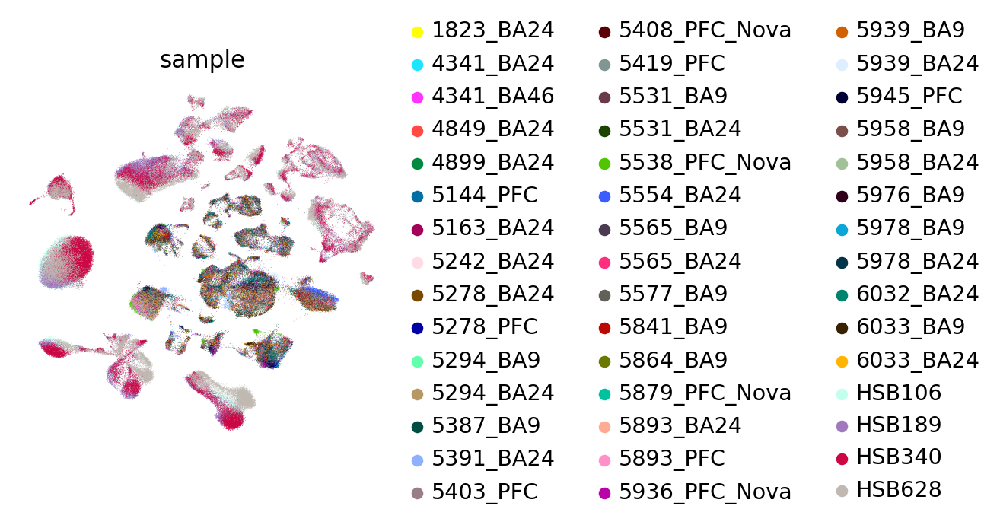

In [ ]:
sc.pl.umap(ad3, color=['sample'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


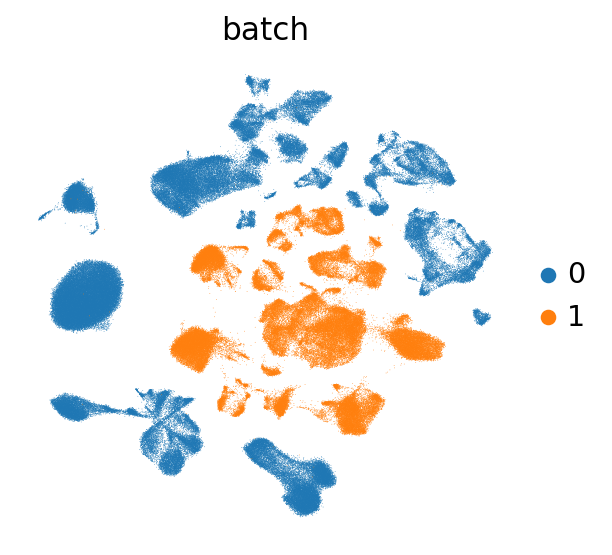

In [ ]:
sc.pl.umap(ad3, color=['batch'])

In [ ]:
ad3.obsm['X_umap_raw']=ad3.obsm['X_umap']

In [ ]:
sc.external.pp.harmony_integrate(ad3, key = ['batch'])

2023-11-08 17:24:10,749 - harmonypy - INFO - Iteration 1 of 10
2023-11-08 17:26:20,446 - harmonypy - INFO - Iteration 2 of 10
2023-11-08 17:28:16,779 - harmonypy - INFO - Iteration 3 of 10
2023-11-08 17:30:11,138 - harmonypy - INFO - Converged after 3 iterations


In [ ]:
ad3.obsm['X_umap_1']=ad3.obsm['X_umap']

In [ ]:
sc.pp.neighbors(ad3, use_rep='X_pca_harmony')
sc.tl.umap(ad3)

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


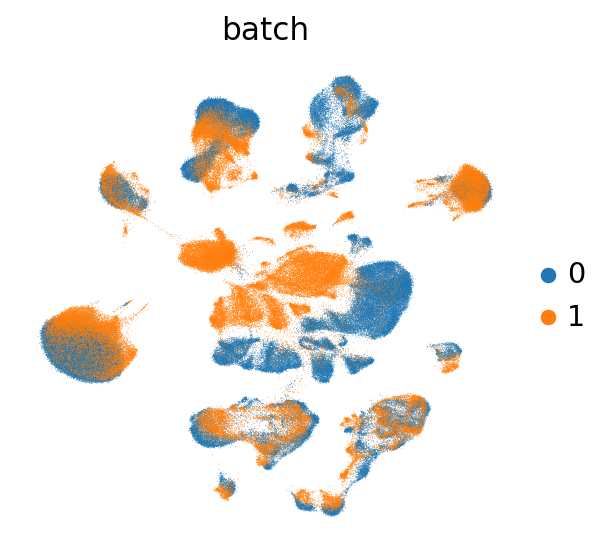

In [ ]:
sc.pl.umap(ad3, color=['batch'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


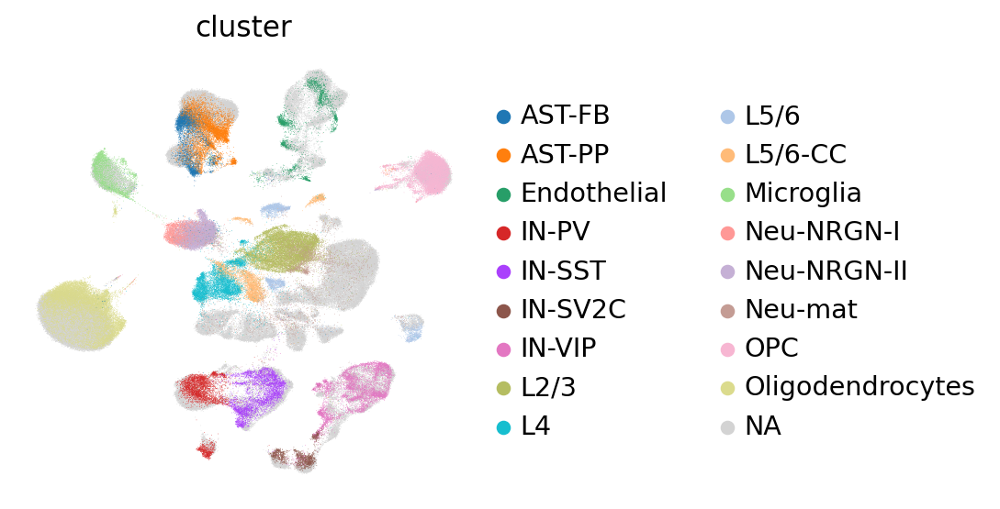

In [ ]:
sc.pl.umap(ad3, color=['cluster'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


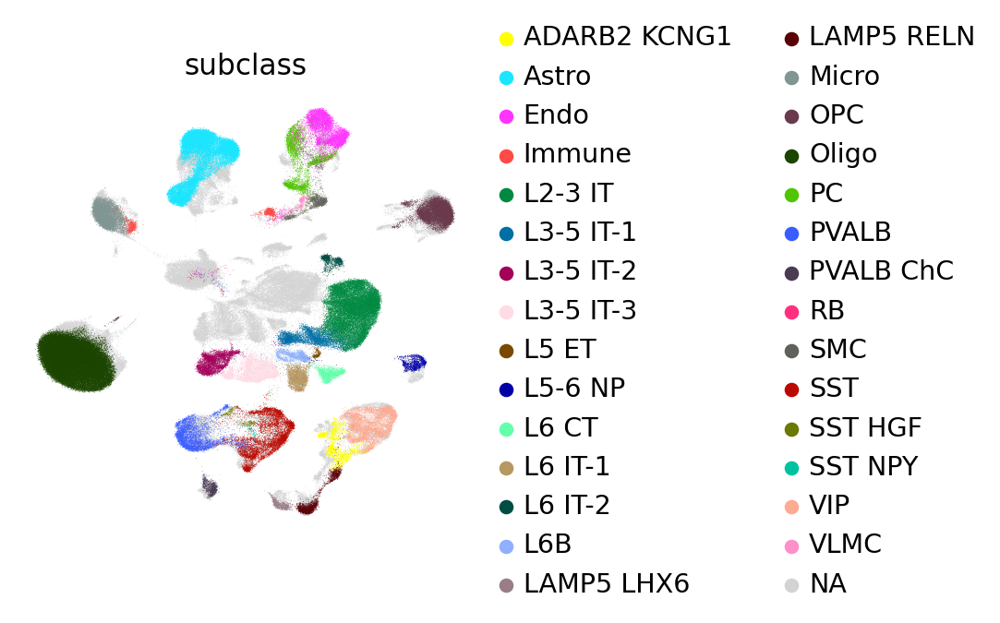

In [ ]:
sc.pl.umap(ad3, color=['subclass'])

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping prov

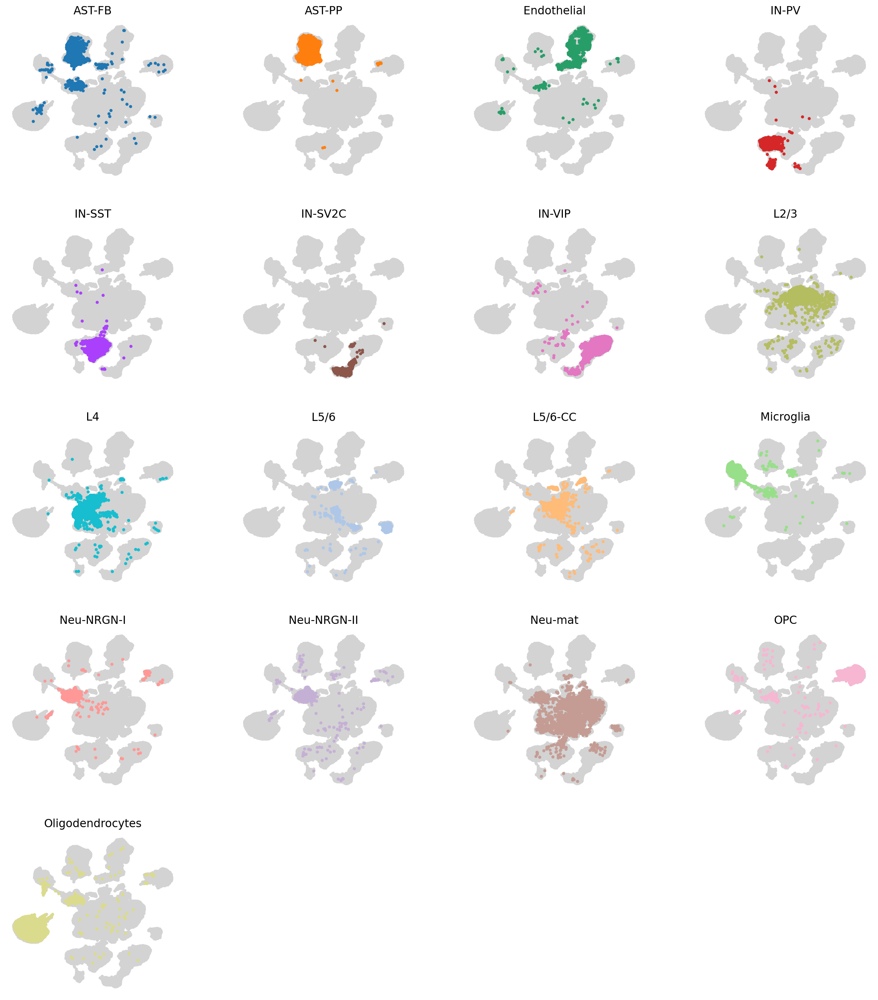

In [ ]:
cluster_small_multiples(ad3,'cluster')

In [ ]:
ad3=ad3[:,~ad3.var_names.isin(['PC','PVALB','SST','VIP'])]

/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/huang_yin/anaconda3/envs/sc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping prov

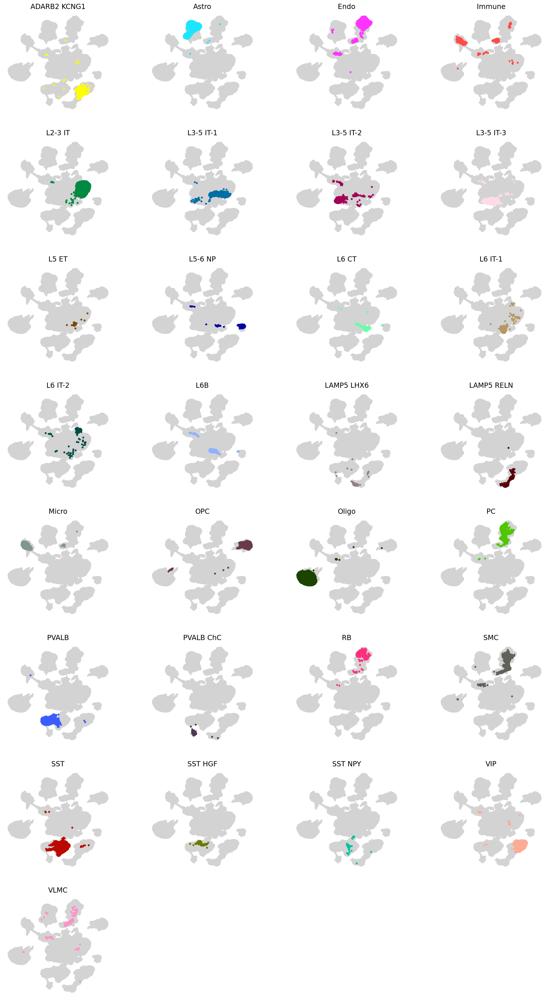

In [ ]:
cluster_small_multiples(ad3,'subclass')

In [ ]:
ad3.write_h5ad('data/integration/as_normlized_data_1e3.h5ad')

In [ ]:
sc.__version__

'1.9.5'

In [ ]:
human_brain_Lau_2020_10x 154846 33538
human_brain_Sadick_2022_10x 125653 36601
human_mouse_brain_source_Gaublomme_2019 39086 29110
human_brain_source_Fatma_2020 122032 17180

human_brain_source_Velmeshev_2019 104559 65217

human_brain_Otero-Garcia_2022_10x 124619 33694


human_brain_PFC_Kihara_2022_10x 33197 33538
human_brain_frontoparietal_Li_2018 17093 23476
human_brain_Microglia_Schirmer_2019_10x 48919 65217
human_brain_source_Tran_2021 72887 33538
human_brain_CV_SunN_2022_10x 22514 15055
mouse_brain_source_Habib_2017 13924 32111



In [ ]:
ms=read_cellbrowser('data/cellbrowserdatasets/ms/')

data/cellbrowserdatasets/ms/ [1.05065 1.05065 1.05065 ... 2.31274 2.31274 2.31274]


In [ ]:
ms

AnnData object with n_obs × n_vars = 48919 × 33741
    obs: 'cell_type', 'sample', 'diagnosis', 'stage', 'age', 'sex', 'region', 'Capbatch', 'Seqbatch', 'RIN', 'PMI', 'genes', 'UMIs', 'mito_perc', 'ribo_perc', 'DMGM_UL', 'DMGM_DL', 'DMWM', 'pseudotime'

In [ ]:
ms.obs

,cell_type,sample,diagnosis,stage,age,sex,region,Capbatch,Seqbatch,RIN,PMI,genes,UMIs,mito_perc,ribo_perc,DMGM_UL,DMGM_DL,DMWM,pseudotime
cell,,,,,,,,,,,,,,,,,,,
AAACCTGGTCCATGAT-1_5981_BA9,EN-L5-6,C8,Control,Control,44,female,prefrontal,CAP7,SEQ5,7.8,19,3674,9333,0.005143,0.002357,NaN,NaN,NaN,NaN
AAACGGGAGTAGCCGA-1_5981_BA9,EN-L2-3-B,C8,Control,Control,44,female,prefrontal,CAP7,SEQ5,7.8,19,2407,4853,0.004945,0.003709,NaN,NaN,NaN,1.555339
AAACGGGCATCGGTTA-1_5981_BA9,IN-PVALB,C8,Control,Control,44,female,prefrontal,CAP7,SEQ5,7.8,19,3593,7668,0.018519,0.006129,NaN,NaN,NaN,NaN
AAACGGGTCCATGAAC-1_5981_BA9,EN-L4,C8,Control,Control,44,female,prefrontal,CAP7,SEQ5,7.8,19,3288,6940,0.016427,0.007061,NaN,NaN,NaN,NaN
AAAGATGCACGACTCG-1_5981_BA9,EN-L5-6,C8,Control,Control,44,female,prefrontal,CAP7,SEQ5,7.8,19,4161,10297,0.007672,0.003108,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAGTGTTAAGA-1_MS200_A303,OL-B,MS12,MS,Chronic inactive,44,female,prefrontal,CAP6,SEQ4,9.0,20,857,1227,0.003260,0.011410,41.0,6.0,12.0,NaN
TTTGTCAGTTCGCGAC-1_MS200_A303,EN-L4,MS12,MS,Chronic inactive,44,female,prefrontal,CAP6,SEQ4,9.0,20,5463,14703,0.010610,0.018160,41.0,6.0,12.0,NaN
TTTGTCAGTTCTGGTA-1_MS200_A303,Astrocytes,MS12,MS,Chronic inactive,44,female,prefrontal,CAP6,SEQ4,9.0,20,1560,2548,0.018838,0.003925,41.0,6.0,12.0,NaN


In [ ]:
ms.obs.diagnosis.value_counts()

MS         31516
Control    17403
Name: diagnosis, dtype: int64

In [ ]:
ms.obs.region.value_counts()

prefrontal        20055
motor-premotor    11492
temporal           9244
parietal           8128
Name: region, dtype: int64

In [ ]:
ms.obs.cell_type.value_counts()

OL-A             9642
Astrocytes       5381
OPC              3844
EN-L2-3-B        3291
EN-L4            3125
EN-L5-6          3058
EN-L2-3-A        2829
IN-VIP           2755
EN-MIX           2403
EN-PYR           2082
IN-PVALB         1897
OL-C             1598
IN-SST           1486
Microglia        1425
Glia-MIX         1226
OL-B             1154
IN-SV2C           779
Endo cells        375
Phagocytes        258
Stromal cells     153
T cells           105
B cells            53
Name: cell_type, dtype: int64

In [ ]:
haging=read_cellbrowser('data/cellbrowserdatasets/aging-brain/')

data/cellbrowserdatasets/aging-brain/ [2.3710601 2.3710601 2.3710601 ... 2.1570113 2.1570113 2.1570113]


In [ ]:
haging

AnnData object with n_obs × n_vars = 72543 × 19746
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'percent.ribo', 'Batch', 'Age', 'Celltype', 'Subtype', 'RNA_snn_res.1.6', 'seurat_clusters', 'Cluster'

In [ ]:
haging.obs

,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,percent.ribo,Batch,Age,Celltype,Subtype,RNA_snn_res.1.6,seurat_clusters,Cluster
Cell,,,,,,,,,,,,
B1_AAACGGGGTAGTGAAT,old1,1030,534,0.076699,0.263107,A,old,imNeur,NaN,24,24,1
B1_AAAGATGGTCCGAGTC,old1,2624,1185,0.027439,0.099466,A,old,MG,NaN,8,8,1
B1_AAAGCAAGTACCTACA,old1,2721,1378,0.087835,0.090408,A,old,EPC,NaN,25,25,1
B1_AAAGCAAGTAGGCATG,old1,3329,1413,0.030039,0.151096,A,old,MG,NaN,8,8,1
B1_AAAGCAAGTCCTCTTG,old1,2961,1318,0.039514,0.118541,A,old,MG,NaN,8,8,1
...,...,...,...,...,...,...,...,...,...,...,...,...
B4_TTTGTCAGTTGCGCAC,young4,1058,587,0.144612,0.108696,C,young,MG,NaN,1,1,4
B4_TTTGTCAGTTTGACTG,young4,1300,719,0.069231,0.188462,C,young,MG,NaN,1,1,4
B4_TTTGTCATCAACGCTA,young4,988,547,0.126518,0.084008,C,young,MG,NaN,1,1,4


In [ ]:
mhip

AnnData object with n_obs × n_vars = 3005 × 19972
    obs: 'tissue', 'group', 'total mRNA mol', 'well', 'sex', 'age', 'diameter', 'level1class', 'level2class', 'Expressed Genes', 'UMI Count'

In [ ]:
mhip.obs

,tissue,group,total mRNA mol,well,sex,age,diameter,level1class,level2class,Expressed Genes,UMI Count
1772071015-C02,sscortex,1,21580,11,1,21,0.00,interneurons,Int10,4848,9268.8200
1772071017-G12,sscortex,1,21748,95,-1,20,9.56,interneurons,Int10,4685,9050.3040
1772071017-A05,sscortex,1,31642,33,-1,20,11.10,interneurons,Int6,6028,12301.0680
1772071014-B06,sscortex,1,32916,42,1,21,11.70,interneurons,Int10,5824,12027.4550
1772067065-H06,sscortex,1,21531,48,1,25,11.00,interneurons,Int9,4701,9335.1040
...,...,...,...,...,...,...,...,...,...,...,...
1772067059-B04,ca1hippocampus,9,4585,26,-1,23,9.85,endothelial-mural,Peric,2221,3087.5852
1772066097-D04,ca1hippocampus,9,2559,28,-1,26,11.00,endothelial-mural,Vsmc,1428,1870.4265
1772063068-D01,sscortex,9,4015,4,1,26,8.63,endothelial-mural,Vsmc,1977,2673.3535
1772066098-A12,ca1hippocampus,9,2896,89,-1,26,9.23,endothelial-mural,Vsmc,1493,1915.8025
